### 📊 Diabetes Dataset Analysis & Medical Cost Personal Datasets
This notebook presents a comprehensive analysis of two healthcare-related datasets:

Diabetes Dataset (load_diabetes from scikit-learn)

Medical Cost Personal Dataset (insurance charges and patient demographics)

The project demonstrates a complete machine learning workflow using Python, including:

Exploratory Data Analysis (EDA) — identifying patterns, distributions, and relationships

Feature Engineering — transforming and enriching raw data to improve model performance

Model Searching — testing multiple algorithms and hyperparameter configurations

Model Evaluation — assessing predictive accuracy and generalization using metrics such as R² and cross-validation

This notebook aims to showcase reproducible, interpretable, and scalable modeling techniques applicable to real-world regression tasks in healthcare analytics. It also highlights a critical insight: not every dataset allows for high predictive performance, emphasizing the importance of realistic expectations and thoughtful model assessment

### 🔍 Starting with the Diabetes Dataset
We begin our analysis with the Diabetes Dataset, a well-known regression benchmark available through scikit-learn. This dataset contains ten baseline variables (e.g., age, sex, BMI, blood pressure, and serum measurements) collected from diabetes patients, along with a quantitative target representing disease progression.

The following steps will guide our exploration:

Data overview and structure

Exploratory Data Analysis (EDA)

Feature engineering and transformation

Model selection and evaluation

%%html
<style>
    table {
        width: 100%;
        border-collapse: collapse;
        margin-top: 20px;
    }
    th, td {
        border: 1px solid #aaa;
        padding: 8px;
        text-align: left;
    }
    th {
        background-color: #9f0c0cff;
    }
    caption {
        font-size: 1.2em;
        font-weight: bold;
        margin-bottom: 10px;
    }
</style>

<table>
    <caption>🧠 Biological Impact of Features on Glucose Levels</caption>
    <thead>
        <tr>
            <th>Feature</th>
            <th>Description</th>
            <th>Biological Impact on Blood Sugar</th>
        </tr>
    </thead>
    <tbody>
        <tr><td>age</td><td>Patient's age</td><td>With age, the risk of insulin resistance and reduced pancreatic function increases.</td></tr>
        <tr><td>sex</td><td>Gender</td><td>Men and women differ hormonally — estrogen may offer protection against type 2 diabetes.</td></tr>
        <tr><td>bmi</td><td>Body Mass Index</td><td>Higher BMI = more fat tissue → increased insulin resistance → elevated blood sugar levels.</td></tr>
        <tr><td>bp</td><td>Blood pressure</td><td>Hypertension often coexists with diabetes and may impair vascular and insulin function.</td></tr>
        <tr><td>s1 (TC)</td><td>Total cholesterol</td><td>High levels may indicate metabolic issues, though the impact on glucose is indirect.</td></tr>
        <tr><td>s2 (LDL)</td><td>"Bad" cholesterol</td><td>Elevated LDL suggests atherosclerosis risk but doesn’t directly affect glucose levels.</td></tr>
        <tr><td>s3 (HDL)</td><td>"Good" cholesterol</td><td>Higher HDL is protective — associated with better insulin sensitivity.</td></tr>
        <tr><td>s4 (TCH)</td><td>Total cholesterol/HDL ratio</td><td>High ratio may signal metabolic risk and insulin resistance.</td></tr>
        <tr><td>s5 (LTG)</td><td>Triglycerides (log-transformed)</td><td>High triglycerides strongly correlate with insulin resistance and elevated glucose.</td></tr>
        <tr><td>s6 (IGF)</td><td>Insulin-like Growth Factor</td><td>IGF-1 influences glucose metabolism; low levels may impair blood sugar control.</td></tr>
    </tbody>
</table>

<p><strong>Sources:</strong> LSU Diabetes Dataset Analysis, GitHub – Measure of Diabetes Progression</p>


In [ ]:
# Core libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

# Visualization
import seaborn as sns
%matplotlib inline
# Scikit-learn utilities
from sklearn.datasets import load_diabetes
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import (
    StandardScaler, MinMaxScaler, MaxAbsScaler,
    PolynomialFeatures
)
from sklearn.pipeline import Pipeline
from sklearn.metrics import r2_score

# Regression models
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.ensemble import (
    RandomForestRegressor, GradientBoostingRegressor,
    StackingRegressor, VotingRegressor
)

# External models
from xgboost import XGBRegressor
import warnings
warnings.filterwarnings("ignore")

# Load the unscaled diabetes dataset from scikit-learn
diabetes_unscaled = load_diabetes(scaled=False)

# Convert feature data to a Pandas DataFrame
df_diabetes = pd.DataFrame(diabetes_unscaled.data, columns=diabetes_unscaled['feature_names'])

# Add the target variable to the DataFrame
df_diabetes['target'] = diabetes_unscaled.target

# Preview the first few rows of the dataset
df_diabetes.head()


,age,sex,bmi,bp,s1,s2,s3,s4,s5,s6,target
0,59.0,2.0,32.1,101.0,157.0,93.2,38.0,4.0,4.8598,87.0,151.0
1,48.0,1.0,21.6,87.0,183.0,103.2,70.0,3.0,3.8918,69.0,75.0
2,72.0,2.0,30.5,93.0,156.0,93.6,41.0,4.0,4.6728,85.0,141.0
3,24.0,1.0,25.3,84.0,198.0,131.4,40.0,5.0,4.8903,89.0,206.0
4,50.0,1.0,23.0,101.0,192.0,125.4,52.0,4.0,4.2905,80.0,135.0


In [3]:
# The .info() method provides a summary of column types and non-null counts.

print(df_diabetes.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 442 entries, 0 to 441
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   age     442 non-null    float64
 1   sex     442 non-null    float64
 2   bmi     442 non-null    float64
 3   bp      442 non-null    float64
 4   s1      442 non-null    float64
 5   s2      442 non-null    float64
 6   s3      442 non-null    float64
 7   s4      442 non-null    float64
 8   s5      442 non-null    float64
 9   s6      442 non-null    float64
 10  target  442 non-null    float64
dtypes: float64(11)
memory usage: 38.1 KB
None


In [4]:
#Checks for any missing values across the entire DataFrame.
print(f'Null values: {df_diabetes.isnull().sum().sum()}')

Null values: 0


In [5]:
# Generating descriptive statistics for all numerical features in the dataset.
# This includes count, mean, standard deviation, min, max, and quartile values.
# Useful for identifying feature scales, distributions, and potential outliers.
df_diabetes.describe()


,age,sex,bmi,bp,s1,s2,s3,s4,s5,s6,target
count,442.000000,442.000000,442.000000,442.000000,442.000000,442.000000,442.000000,442.000000,442.000000,442.000000,442.000000
mean,48.518100,1.468326,26.375792,94.647014,189.140271,115.439140,49.788462,4.070249,4.641411,91.260181,152.133484
std,13.109028,0.499561,4.418122,13.831283,34.608052,30.413081,12.934202,1.290450,0.522391,11.496335,77.093005
min,19.000000,1.000000,18.000000,62.000000,97.000000,41.600000,22.000000,2.000000,3.258100,58.000000,25.000000
25%,38.250000,1.000000,23.200000,84.000000,164.250000,96.050000,40.250000,3.000000,4.276700,83.250000,87.000000
50%,50.000000,1.000000,25.700000,93.000000,186.000000,113.000000,48.000000,4.000000,4.620050,91.000000,140.500000
75%,59.000000,2.000000,29.275000,105.000000,209.750000,134.500000,57.750000,5.000000,4.997200,98.000000,211.500000
max,79.000000,2.000000,42.200000,133.000000,301.000000,242.400000,99.000000,9.090000,6.107000,124.000000,346.000000


In [6]:
# We temporarily add a categorical column 'target_bin' by dividing the continuous target into tertiles.
# This helps us explore how other features behave across low, medium, and high target ranges.
# After inspecting the distribution, we drop the column to keep the dataset clean.
df_diabetes['target_bin'] = pd.qcut(df_diabetes['target'], q=3, labels=['low', 'medium', 'high'])
print(df_diabetes['target_bin'].value_counts())
df_diabetes.drop(columns='target_bin', inplace=True)


target_bin
high      148
low       147
medium    147
Name: count, dtype: int64


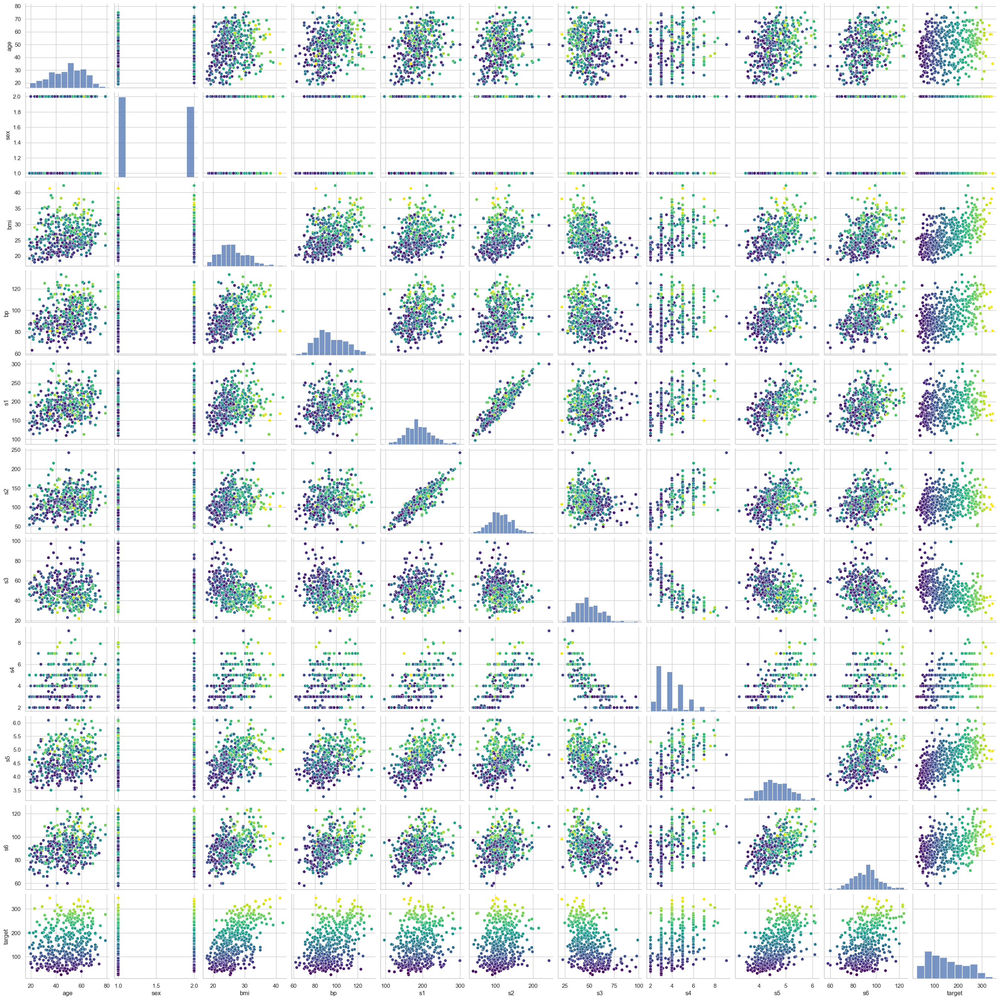

In [7]:
import seaborn as sns

sns.set(style="whitegrid")
# Generate a pairplot with scatter plots color-coded by the continuous target variable
# This helps visually assess relationships between features and how they correlate with the target
pairplot = sns.pairplot(df_diabetes,
                        plot_kws={'c': df_diabetes['target'], 'cmap': 'viridis'})





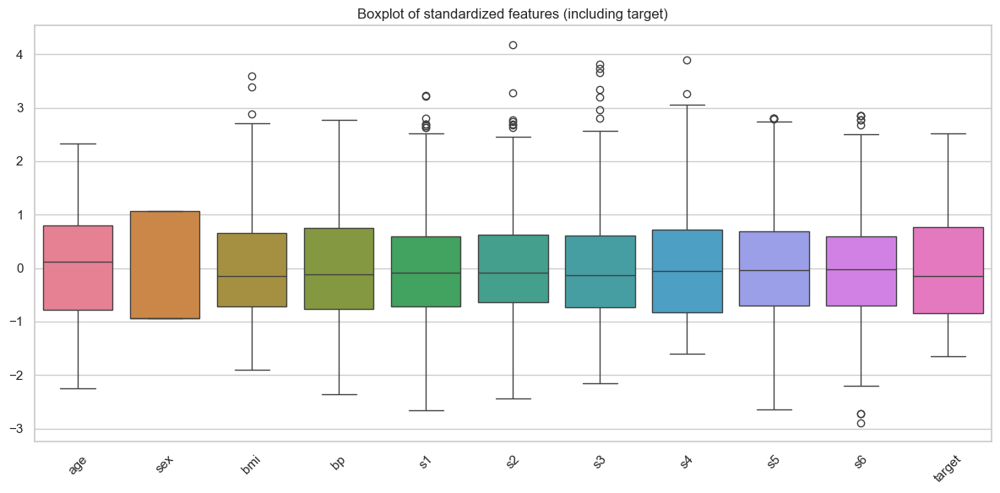

In [8]:
# We temporarily scale all features (including the target) using StandardScaler
# to visualize their distributions on a comparable scale.
# This helps identify outliers, skewness, and feature spread via boxplots.
sc = StandardScaler()
scdf = pd.DataFrame(sc.fit_transform(df_diabetes), columns=df_diabetes.columns)

# Boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(data=scdf)
plt.xticks(rotation=45)
plt.title("Boxplot of standardized features (including target)")
plt.tight_layout()
plt.show()


<Axes: >

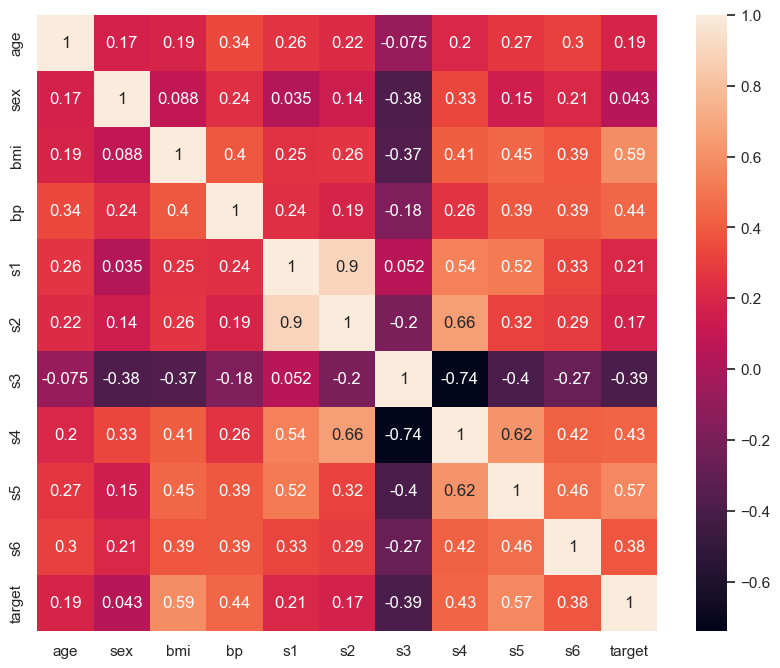

In [9]:
# Computing the correlation matrix to examine linear relationships between features.
# A heatmap is used to visualize the strength and direction of these correlations.
# This helps identify multicollinearity, redundant features, and potential predictors for modeling.
corelation = df_diabetes.corr()

plt.figure(figsize=(10,8))
sns.heatmap(corelation, annot=True)


## 🔧 Feature Engineering

To improve model performance and capture non-linear relationships, we engineer new features based on domain intuition and interaction logic.

This includes:

- **Squared terms**: Non-linear transformations of continuous variables to model curvature or saturation effects. For example:
  - `bmi²`: may enhance modeling of obesity-related risks
  - `bp²`: may capture vascular stress patterns
  - `s5²` and `s6²`: may reflect metabolic or hormonal nonlinearities

- **Interaction terms**: Multiplicative combinations of features to capture synergistic effects between variables. For example:
  - `age × bmi`: older individuals with higher BMI may exhibit different risk patterns
  - `sex × bp`: blood pressure effects may differ by sex

These engineered features aim to expose hidden structure in the data that linear models might otherwise miss.


In [10]:
# Feature engineering: create squared terms to capture potential non-linear relationships
df_diabetes['bmi2'] = df_diabetes['bmi']**2   # BMI squared — may enhance modeling of obesity-related effects
df_diabetes['bp2'] = df_diabetes['bp']**2     # Blood pressure squared — may capture vascular stress patterns
df_diabetes['s52'] = df_diabetes['s5']**2     # Triglycerides squared — may improve modeling of metabolic risk
df_diabetes['s6s'] = df_diabetes['s6']**2     # IGF squared — may help capture hormonal influence on glucose

# Create interaction terms to model potential synergistic effects between age/sex and other features
df_diabetes['agebmi'] = df_diabetes['bmi'] * df_diabetes['age']    # Interaction: age × BMI
df_diabetes['agebp'] = df_diabetes['bp'] * df_diabetes['age']      # Interaction: age × blood pressure
df_diabetes['sexbmi'] = df_diabetes['bmi'] * df_diabetes['sex']    # Interaction: sex × BMI
df_diabetes['sexbp'] = df_diabetes['bp'] * df_diabetes['sex']      # Interaction: sex × blood pressure

# Preview the updated dataset with new features
df_diabetes.head()


,age,sex,bmi,bp,s1,s2,s3,s4,s5,s6,target,bmi2,bp2,s52,s6s,agebmi,agebp,sexbmi,sexbp
0,59.0,2.0,32.1,101.0,157.0,93.2,38.0,4.0,4.8598,87.0,151.0,1030.41,10201.0,23.617656,7569.0,1893.9,5959.0,64.2,202.0
1,48.0,1.0,21.6,87.0,183.0,103.2,70.0,3.0,3.8918,69.0,75.0,466.56,7569.0,15.146107,4761.0,1036.8,4176.0,21.6,87.0
2,72.0,2.0,30.5,93.0,156.0,93.6,41.0,4.0,4.6728,85.0,141.0,930.25,8649.0,21.835060,7225.0,2196.0,6696.0,61.0,186.0
3,24.0,1.0,25.3,84.0,198.0,131.4,40.0,5.0,4.8903,89.0,206.0,640.09,7056.0,23.915034,7921.0,607.2,2016.0,25.3,84.0
4,50.0,1.0,23.0,101.0,192.0,125.4,52.0,4.0,4.2905,80.0,135.0,529.00,10201.0,18.408390,6400.0,1150.0,5050.0,23.0,101.0


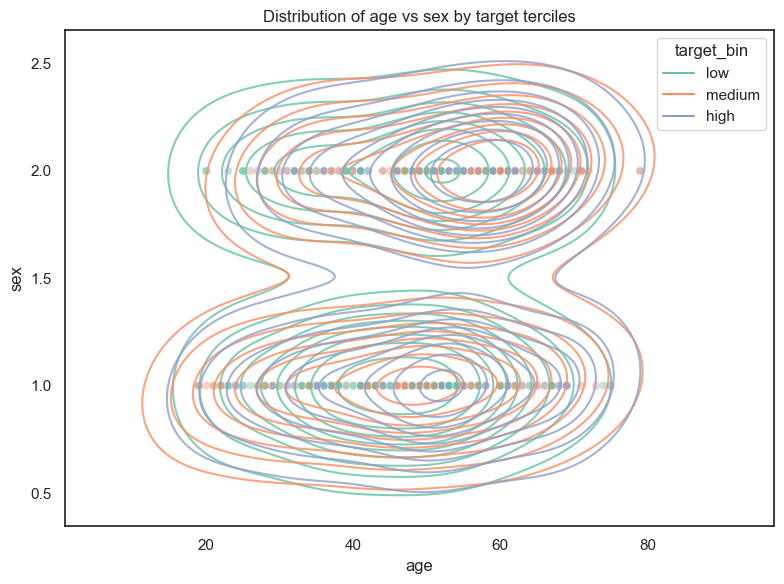

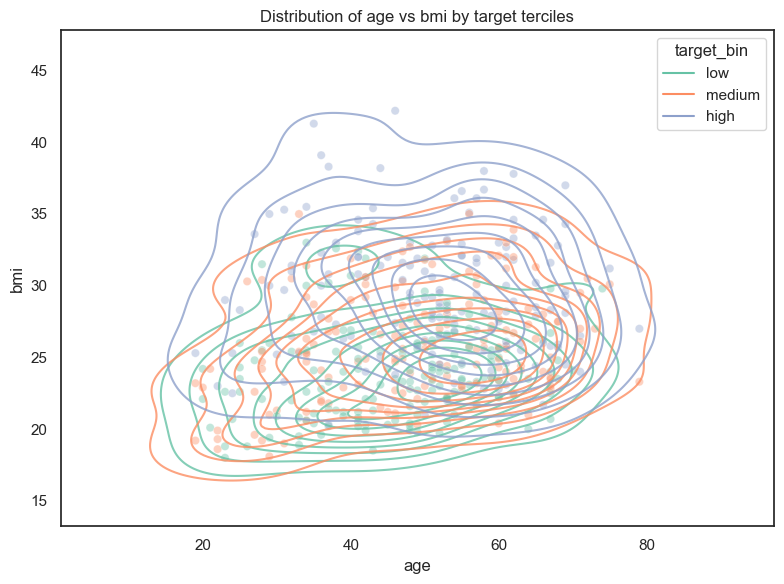

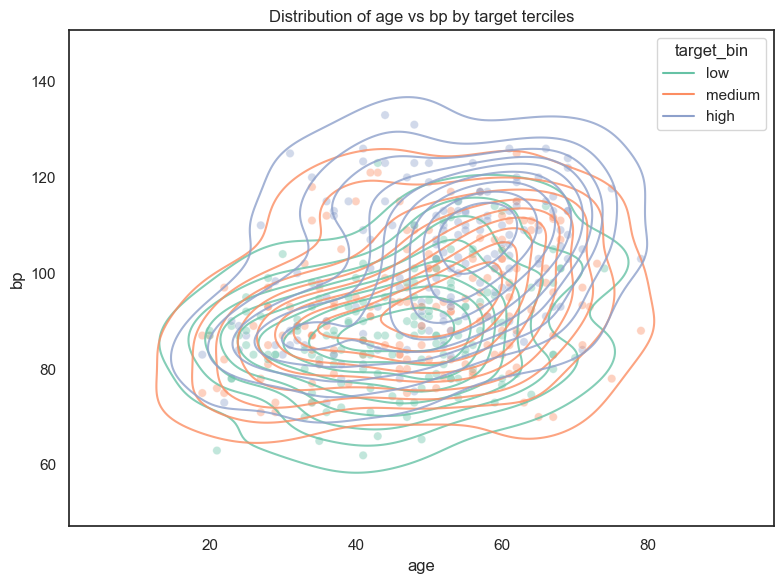

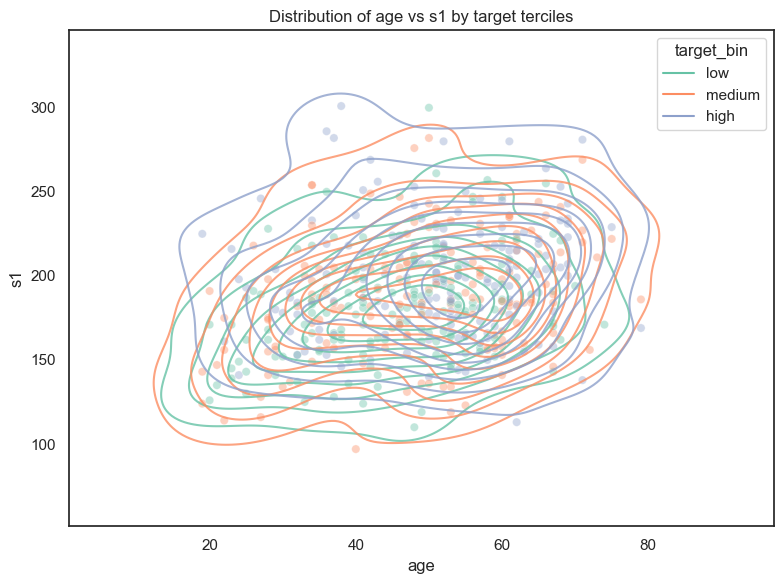

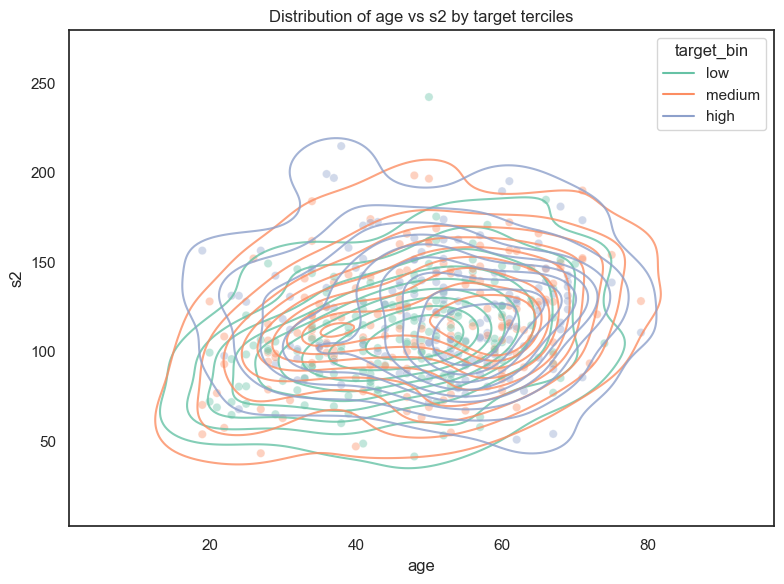

...

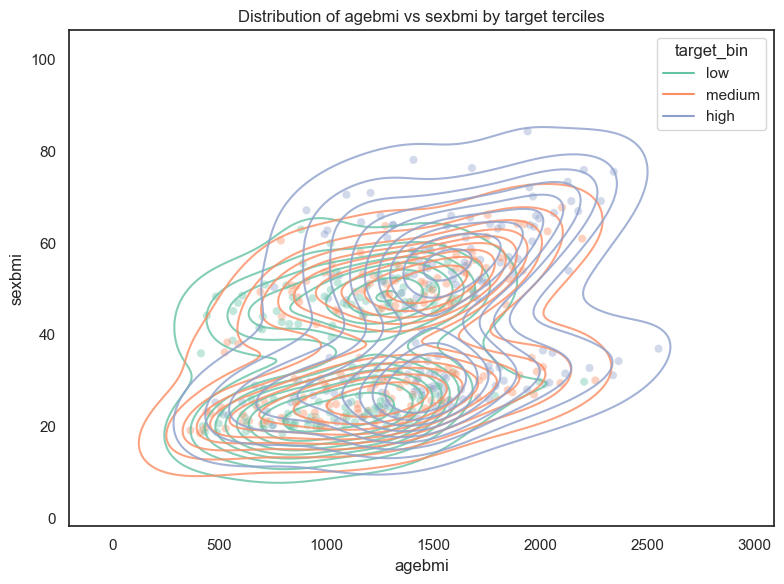

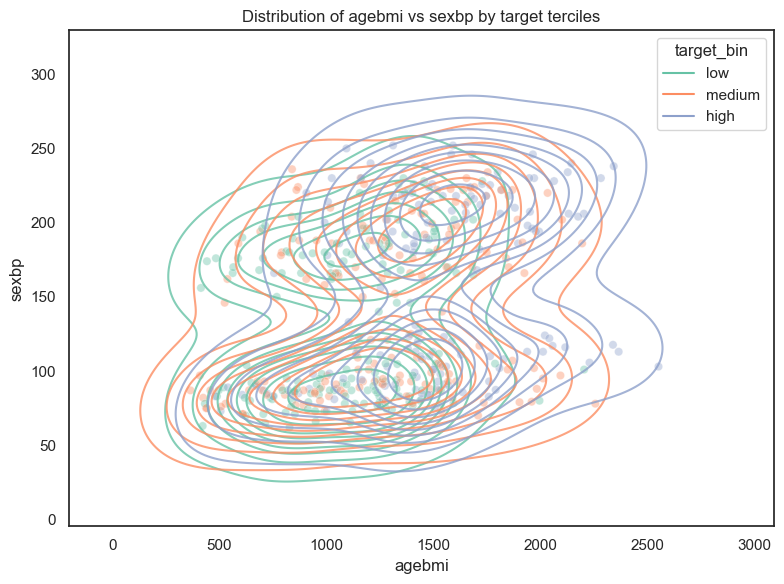

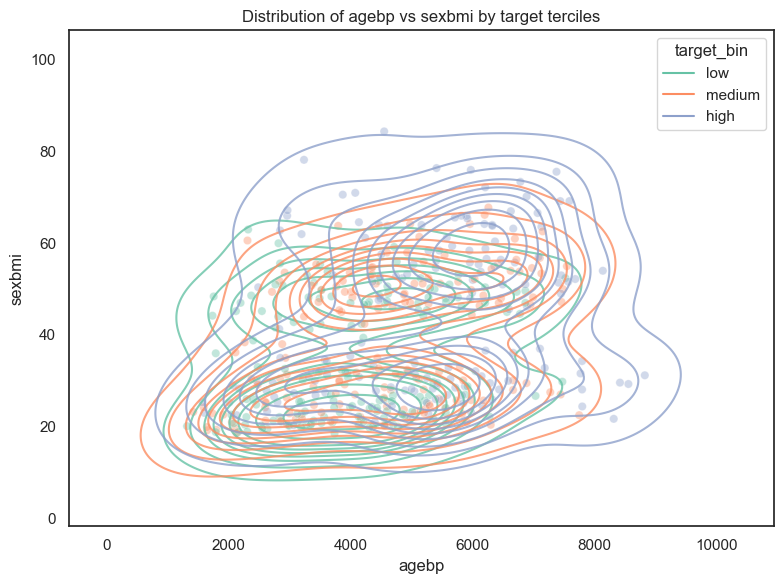

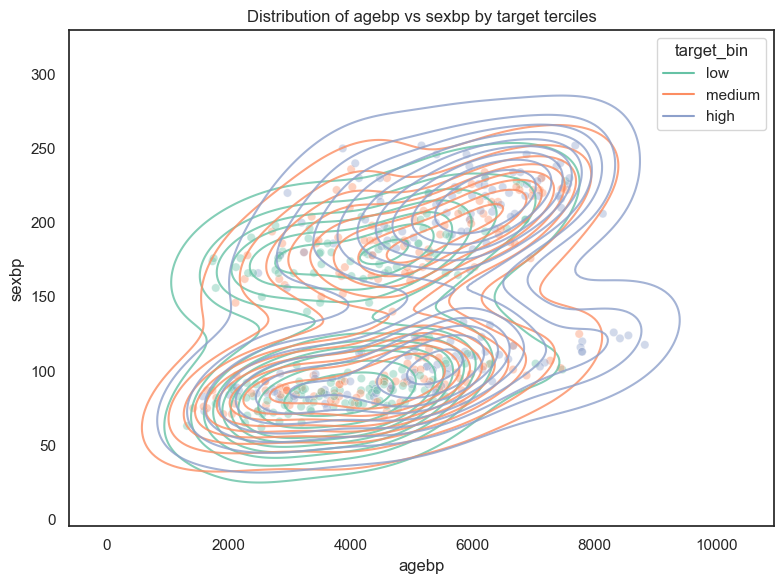

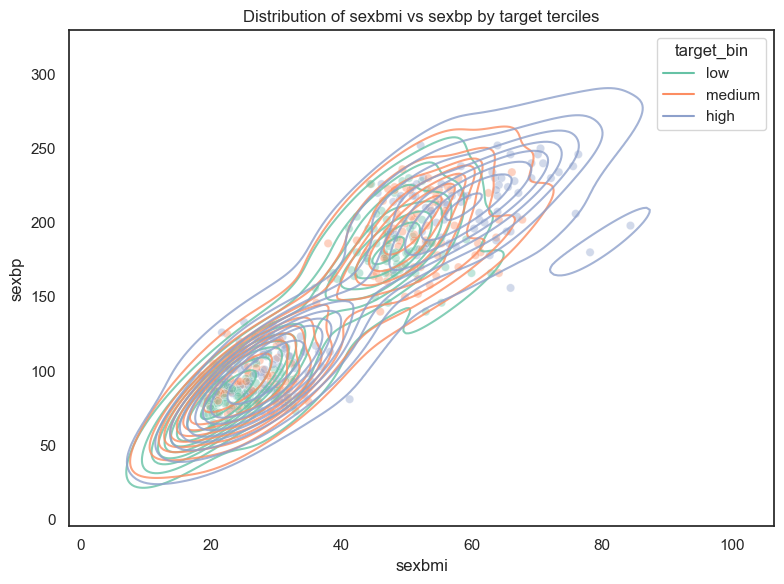

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt
from itertools import combinations

# Temporarily bin the continuous target variable into three equal-sized groups (terciles)
# This allows us to visualize feature relationships across low, medium, and high target ranges
df_diabetes['target_bin'] = pd.qcut(df_diabetes['target'], q=3, labels=['low', 'medium', 'high'])

# Select all feature columns except the target and the temporary bin column
features = [col for col in df_diabetes.columns if col not in ['target', 'target_bin']]

# Generate KDE + scatter plots for every pairwise combination of features
for x, y in combinations(features, 2):
    plt.figure(figsize=(8, 6))
    sns.set(style="white", context="notebook")

    # KDE contours for each target_bin group to show density distribution
    sns.kdeplot(
        data=df_diabetes,
        x=x,
        y=y,
        hue='target_bin',
        fill=False,
        common_norm=False,
        palette='Set2',
        linewidth=2,
        alpha=0.8
    )

    # Optional scatter points to show actual data distribution
    sns.scatterplot(
        data=df_diabetes,
        x=x,
        y=y,
        hue='target_bin',
        palette='Set2',
        edgecolor='white',
        linewidth=0.5,
        alpha=0.4,
        legend=False
    )

    # Plot aesthetics
    plt.title(f"Distribution of {x} vs {y} by target terciles")
    plt.xlabel(x)
    plt.ylabel(y)
    plt.tight_layout()
    plt.show()

# Remove the temporary bin column to restore the original dataset
df_diabetes.drop(columns='target_bin', inplace=True)


📉 Observations from Feature Pair Distributions
The pairwise KDE and scatter plots reveal that the features in this dataset are highly interwoven and overlapping across target terciles. There is no clear separation between low, medium, and high target groups in most feature combinations, which suggests:

Limited linear separability between classes

Weak or noisy signal in individual features

High feature interaction complexity, potentially requiring non-linear or ensemble methods

These patterns indicate that building a high-performing predictive model may be challenging. It reinforces the importance of realistic model evaluation, and highlights that not every dataset is suited for achieving strong predictive accuracy, especially when the underlying relationships are subtle or obscured by noise.

In [12]:
# Define feature matrix X and target vector y
# Exclude 'target' (regression label) and 's4' (cholesterol ratio — dropped due to potential multicollinearity or low importance)
X = df_diabetes.drop(['target'], axis=1)
y = df_diabetes['target']

# Initialize a list to store model evaluation results (e.g., R² scores)
results_list = []


In [13]:
# Loop over different test set sizes to evaluate model robustness
for t in [0.25, 0.35, 0.30]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=t, random_state=42)

    # Define preprocessing pipelines: each scaler combined with PolynomialFeatures (degree 2)
    scalers = {
        'StandardScaler+Poly_D2': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MinMaxScaler+Poly_D2': Pipeline([
            ('scaler', MinMaxScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MaxAbsScaler+Poly_D2': Pipeline([
            ('scaler', MaxAbsScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ])
    }

    # Define a diverse set of models and their hyperparameter grids
    models = {
        'Lasso': (Lasso(random_state=42, max_iter=2000), {
            'model__alpha': [0.001, 0.01, 0.1]
        }),

        'ElasticNet': (ElasticNet(random_state=42, max_iter=2000), {
            'model__alpha': [0.01, 0.1],
            'model__l1_ratio': [0.3, 0.7]
        }),

        'RandomForest': (RandomForestRegressor(random_state=42), {
            'model__n_estimators': [100, 200],
            'model__max_depth': [3, 5],
            'model__min_samples_split': [2],
            'model__min_samples_leaf': [2]
        }),

        'GradientBoosting': (GradientBoostingRegressor(random_state=42), {
            'model__n_estimators': [100, 200],
            'model__learning_rate': [0.05, 0.1]
        }),

        'XGBoost': (XGBRegressor(random_state=42, use_label_encoder=False, eval_metric='rmse'), {
            'model__n_estimators': [100, 200],
            'model__learning_rate': [0.05, 0.1]
        }),

        # Ensemble models with hyperparameter tuning of base learners
        'StackingRegressor': (StackingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ],
            final_estimator=Lasso(random_state=42)
        ), {
            'model__ridge__alpha': [0.1, 1.0, 10.0],
            'model__rfr__max_depth': [3, 5],
            'model__final_estimator__alpha': [0.001, 0.01]
        }),

        'VotingRegressor': (VotingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ]
        ), {
            'model__ridge__alpha': [0.1, 1.0, 10.0],
            'model__rfr__max_depth': [3, 5]
            # Optional: 'model__weights': [[1, 1], [2, 1]]
        })
    }

    # Track the best model for the current test size
    best_score = -float('inf')
    best_model = None
    best_scaler_name = ''
    best_t = t

    # Iterate over all preprocessing pipelines
    for scaler_name, scaler_pipeline in scalers.items():
        print(f"\n--- Testing with preprocessor: {scaler_name} (Test size: {t}) ---")

        # Iterate over all models and their parameter grids
        for model_name, (model, params) in models.items():
            pipe = Pipeline([
                ('preprocessing', scaler_pipeline),
                ('model', model)
            ])

            try:
                # Perform grid search with cross-validation
                grid = GridSearchCV(pipe, param_grid=params, cv=3, scoring='r2', n_jobs=-1, verbose=0)
                grid.fit(X_train, y_train)
                y_pred = grid.predict(X_test)
                score = r2_score(y_test, y_pred)

                # Check if PolynomialFeatures was used
                try:
                    poly_degree = pipe.named_steps['preprocessing'].named_steps['poly'].degree
                except:
                    poly_degree = None

                # Store results
                results_list.append({
                    'Preprocessor': scaler_name,
                    'Model': model_name,
                    'Test_Size': t,
                    'R2_Test_Score': score,
                    'R2_CrossVal_Score': grid.best_score_,
                    'Best_Parameters': str(grid.best_params_),
                    'Polynomial_Degree': poly_degree
                })


                print(f"[{model_name}]: R² = {score:.4f} (Best params: {grid.best_params_})")

                # Update best model if current one is better
                if score > best_score:
                    best_score = score
                    best_model = grid.best_estimator_
                    best_scaler_name = scaler_name

            except Exception as e:
                print(f"[{model_name}]: ❌ Grid Search ERROR: {e}")
                pass

    # Summary for current test size
    print("\n=========================================================")
    print("✅ END OF OPTIMIZATION FOR CURRENT TEST SIZE")
    print("=========================================================")
    print(f"📈 Test size: {best_t}")
    print(f"📈 Best R² score: {best_score:.4f}")
    print(f"🔬 Best Preprocessor: {best_scaler_name}")
    print("🏆 Best Model (Pipeline):")
    print(best_model)

# Compile all results into a DataFrame
results_df = pd.DataFrame(results_list)
results_df_sorted = results_df.sort_values(by='R2_Test_Score', ascending=False).reset_index(drop=True)

print("\n" + "="*80)
print("🏆 ALL MODEL RESULTS (sorted by R² on test set):")
print("="*80)
print(results_df_sorted.head(20).to_string())

print("\n" + "="*80)
print(f"🎯 Best result with R² > 0.55:")
print("="*80)

# Focus on models that achieve R² > 0.55 — a practical threshold for acceptable predictive performance
best_result_row = results_df_sorted[results_df_sorted['R2_Test_Score'] > 0.55].head(1)

if not best_result_row.empty:
    print(best_result_row.to_string(index=False))
else:
    print("No models achieved R² above 0.55 in this run.")
    print("Suggested next steps: increase polynomial degree or expand hyperparameter search space.")



--- Testing with preprocessor: StandardScaler+Poly_D2 (Test size: 0.25) ---
[Lasso]: R² = 0.3944 (Best params: {'model__alpha': 0.1})
[ElasticNet]: R² = 0.4823 (Best params: {'model__alpha': 0.1, 'model__l1_ratio': 0.3})
[RandomForest]: R² = 0.4798 (Best params: {'model__max_depth': 5, 'model__min_samples_leaf': 2, 'model__min_samples_split': 2, 'model__n_estimators': 200})
[GradientBoosting]: R² = 0.4509 (Best params: {'model__learning_rate': 0.05, 'model__n_estimators': 100})
[XGBoost]: R² = 0.3738 (Best params: {'model__learning_rate': 0.05, 'model__n_estimators': 100})
[StackingRegressor]: R² = 0.5162 (Best params: {'model__final_estimator__alpha': 0.01, 'model__rfr__max_depth': 3, 'model__ridge__alpha': 10.0})
[VotingRegressor]: R² = 0.5180 (Best params: {'model__rfr__max_depth': 3, 'model__ridge__alpha': 10.0})

--- Testing with preprocessor: MinMaxScaler+Poly_D2 (Test size: 0.25) ---
[Lasso]: R² = 0.5164 (Best params: {'model__alpha': 0.1})
[ElasticNet]: R² = 0.5059 (Best param

In [14]:
# Summary of all model runs, sorted by R² score on the test set.
# Although RandomForest  show relatively better performance (R² ≈ 0.58),
# the overall results remain modest and below expectations for strong predictive accuracy.
# This suggests that the dataset's signal is weak or complex, and further optimization is needed.
# As a next step, we will focus on deeper hyperparameter tuning for RandomForest and XGBoost,
# potentially expanding the search space and increasing model complexity to improve results.
results_df_sorted.head(20)

,Preprocessor,Model,Test_Size,R2_Test_Score,R2_CrossVal_Score,Best_Parameters,Polynomial_Degree
0,MaxAbsScaler+Poly_D2,RandomForest,0.25,0.580942,0.422216,"{'model__max_depth': 3, 'model__min_samples_le...",2
1,MinMaxScaler+Poly_D2,RandomForest,0.25,0.571509,0.420177,"{'model__max_depth': 3, 'model__min_samples_le...",2
2,MaxAbsScaler+Poly_D2,VotingRegressor,0.25,0.556905,0.464977,"{'model__rfr__max_depth': 3, 'model__ridge__al...",2
3,MaxAbsScaler+Poly_D2,XGBoost,0.25,0.555036,0.347935,"{'model__learning_rate': 0.05, 'model__n_estim...",2
4,MinMaxScaler+Poly_D2,VotingRegressor,0.25,0.549194,0.460178,"{'model__rfr__max_depth': 3, 'model__ridge__al...",2
5,MaxAbsScaler+Poly_D2,RandomForest,0.35,0.532788,0.372176,"{'model__max_depth': 5, 'model__min_samples_le...",2
6,MaxAbsScaler+Poly_D2,GradientBoosting,0.25,0.531766,0.392725,"{'model__learning_rate': 0.05, 'model__n_estim...",2
7,MinMaxScaler+Poly_D2,VotingRegressor,0.35,0.529741,0.419647,"{'model__rfr__max_depth': 5, 'model__ridge__al...",2
8,MinMaxScaler+Poly_D2,RandomForest,0.35,0.527205,0.364067,"{'model__max_depth': 3, 'model__min_samples_le...",2
9,MaxAbsScaler+Poly_D2,VotingRegressor,0.35,0.526995,0.423354,"{'model__rfr__max_depth': 5, 'model__ridge__al...",2


In [15]:
# 🔁 New experiment: re-running model optimization to improve R² scores
# This iteration tests multiple scalers, polynomial degrees, and model configurations
results_list = []

# Iterate over different test sizes to evaluate generalization
for t in [0.25, 0.35]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=t, random_state=42)

    # Define preprocessing pipelines: each scaler with or without PolynomialFeatures (degree 2 or raw features)
    scalers = {
        'StandardScaler+Poly_D2': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MinMaxScaler+Poly_D2': Pipeline([
            ('scaler', MinMaxScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MaxAbsScaler+Poly_D2': Pipeline([
            ('scaler', MaxAbsScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler+Poly_D1': Pipeline([
            ('scaler', StandardScaler())
        ]),
        'MinMaxScaler+Poly_D1': Pipeline([
            ('scaler', MinMaxScaler())
        ]),
        'MaxAbsScaler+Poly_D1': Pipeline([
            ('scaler', MaxAbsScaler())
        ])
    }

    # Define models and their hyperparameter grids
    models = {
        'RandomForest': (RandomForestRegressor(random_state=42), {
            # Reduced grid size to avoid excessive computation
            'model__n_estimators': [100, 200, 300],
            'model__max_depth': [1, 2, 3],
            'model__min_samples_split': [2, 5],
            'model__criterion': ['squared_error', 'absolute_error', 'friedman_mse', 'poisson'],
            'model__min_samples_leaf': [1, 2]
        }),

        'XGBoost': (XGBRegressor(random_state=42, use_label_encoder=False, eval_metric='rmse'), {
            'model__n_estimators': [100, 200, 300],           # Number of boosting rounds
            'model__learning_rate': [0.01, 0.05, 0.1],        # Lower = more stable learning
            'model__max_depth': [3, 5],                       # Controls model complexity
            'model__subsample': [0.8, 1.0],                   # Fraction of samples per tree
            'model__colsample_bytree': [0.8, 1.0]             # Fraction of features per tree
        })
    }

    # Initialize tracking variables for best model
    best_score = -float('inf')
    best_model = None
    best_scaler_name = ''
    best_t = t

    # Iterate over all preprocessing pipelines
    for scaler_name, scaler_pipeline in scalers.items():
        print(f"\n--- Testing with Preprocessor: {scaler_name} (Test size: {t}) ---")

        # Iterate over all models
        for model_name, (model, params) in models.items():
            pipe = Pipeline([
                ('preprocessing', scaler_pipeline),
                ('model', model)
            ])

            try:
                # Perform grid search with 5-fold cross-validation
                grid = GridSearchCV(pipe, param_grid=params, cv=5, scoring='r2', n_jobs=-1, verbose=0)
                grid.fit(X_train, y_train)
                y_pred = grid.predict(X_test)
                score = r2_score(y_test, y_pred)

                # Extract polynomial degree if present
                try:
                    poly_degree = pipe.named_steps['preprocessing'].named_steps['poly'].degree
                except:
                    poly_degree = None  # No PolynomialFeatures in pipeline

                # Store results
                results_list.append({
                    'Preprocessor': scaler_name,
                    'Model': model_name,
                    'Test_Size': t,
                    'R2_Test_Score': score,
                    'R2_CrossVal_Score': grid.best_score_,
                    'Best_Parameters': str(grid.best_params_),
                    'Polynomial_Degree': poly_degree
                })


                print(f"[{model_name}]: R² = {score:.4f} (Best params: {grid.best_params_})")

                # Update best model if current one is better
                if score > best_score:
                    best_score = score
                    best_model = grid.best_estimator_
                    best_scaler_name = scaler_name

            except Exception as e:
                print(f"[{model_name}]: ❌ Grid Search ERROR: {e}")
                pass

    # Summary of best model for current test size
    print("\n=========================================================")
    print("✅ END OF OPTIMIZATION FOR CURRENT TEST SIZE")
    print("=========================================================")
    print(f"📈 Test size: {best_t}")
    print(f"📈 Best R² score: {best_score:.4f}")
    print(f"🔬 Best Preprocessor: {best_scaler_name}")
    print("🏆 Best Model (Pipeline):")
    print(best_model)

# Create DataFrame from results
results_df = pd.DataFrame(results_list)
results_df_sorted = results_df.sort_values(by='R2_Test_Score', ascending=False).reset_index(drop=True)

# Display top 20 models sorted by test R² score
print("\n" + "="*80)
print("🏆 TOP 20 MODEL CONFIGURATIONS (sorted by R² on test set):")
print("="*80)
print(results_df_sorted.head(20).to_string())

# Display best model with R² > 0.55
print("\n" + "="*80)
print(f"🎯 Best R² score above 0.55:")
print("="*80)

best_result_row = results_df_sorted[results_df_sorted['R2_Test_Score'] > 0.55].head(1)

if not best_result_row.empty:
    print(best_result_row.to_string(index=False))
else:
    print("No models achieved R² above 0.55 in this run.")
    print("Suggested actions: Increase polynomial degree or expand hyperparameter search space.")



--- Testing with Preprocessor: StandardScaler+Poly_D2 (Test size: 0.25) ---
[RandomForest]: R² = 0.4781 (Best params: {'model__criterion': 'squared_error', 'model__max_depth': 3, 'model__min_samples_leaf': 1, 'model__min_samples_split': 5, 'model__n_estimators': 100})
[XGBoost]: R² = 0.4492 (Best params: {'model__colsample_bytree': 0.8, 'model__learning_rate': 0.01, 'model__max_depth': 3, 'model__n_estimators': 300, 'model__subsample': 0.8})

--- Testing with Preprocessor: MinMaxScaler+Poly_D2 (Test size: 0.25) ---
[RandomForest]: R² = 0.5715 (Best params: {'model__criterion': 'squared_error', 'model__max_depth': 3, 'model__min_samples_leaf': 2, 'model__min_samples_split': 2, 'model__n_estimators': 200})
[XGBoost]: R² = 0.5505 (Best params: {'model__colsample_bytree': 0.8, 'model__learning_rate': 0.01, 'model__max_depth': 3, 'model__n_estimators': 300, 'model__subsample': 0.8})

--- Testing with Preprocessor: MaxAbsScaler+Poly_D2 (Test size: 0.25) ---
[RandomForest]: R² = 0.5793 (Best

In [16]:
results_df_sorted['Best_Parameters'][0]


"{'model__criterion': 'squared_error', 'model__max_depth': 3, 'model__min_samples_leaf': 1, 'model__min_samples_split': 5, 'model__n_estimators': 200}"

In [17]:
results_df_sorted

,Preprocessor,Model,Test_Size,R2_Test_Score,R2_CrossVal_Score,Best_Parameters,Polynomial_Degree
0,MaxAbsScaler+Poly_D2,RandomForest,0.25,0.579324,0.410184,"{'model__criterion': 'squared_error', 'model__...",2.0
1,MinMaxScaler+Poly_D2,RandomForest,0.25,0.571509,0.404326,"{'model__criterion': 'squared_error', 'model__...",2.0
2,MaxAbsScaler+Poly_D2,XGBoost,0.25,0.553993,0.402833,"{'model__colsample_bytree': 0.8, 'model__learn...",2.0
3,MinMaxScaler+Poly_D2,XGBoost,0.25,0.550487,0.392905,"{'model__colsample_bytree': 0.8, 'model__learn...",2.0
4,MinMaxScaler+Poly_D2,RandomForest,0.35,0.534753,0.396387,"{'model__criterion': 'poisson', 'model__max_de...",2.0
5,MaxAbsScaler+Poly_D2,RandomForest,0.35,0.527710,0.398693,"{'model__criterion': 'squared_error', 'model__...",2.0
6,MinMaxScaler+Poly_D2,XGBoost,0.35,0.521047,0.379033,"{'model__colsample_bytree': 1.0, 'model__learn...",2.0
7,MaxAbsScaler+Poly_D2,XGBoost,0.35,0.517743,0.381301,"{'model__colsample_bytree': 1.0, 'model__learn...",2.0
8,MinMaxScaler+Poly_D1,XGBoost,0.25,0.496291,0.433033,"{'model__colsample_bytree': 0.8, 'model__learn...",NaN
9,MaxAbsScaler+Poly_D1,XGBoost,0.25,0.496291,0.433033,"{'model__colsample_bytree': 0.8, 'model__learn...",NaN


✅ Closing Remarks: Wrapping Up This Dataset
After extensive experimentation with preprocessing strategies, model architectures, and hyperparameter tuning, we conclude that this dataset has limited predictive potential under the current setup. No configuration surpassed the previous best R² score, and the feature-target relationships remain weak and entangled.

Rather than overfitting or forcing further optimization, we choose to close this phase of analysis and shift focus to the next dataset, where we aim to apply refined techniques and explore new modeling opportunities.

### Medical Cost Personal Datasets

https://www.kaggle.com/datasets/mirichoi0218/insurance/data

💰 Medical Cost Personal Dataset
We now shift focus to the Medical Cost Personal Dataset, available on Kaggle. This dataset contains demographic and lifestyle information for individuals, along with their annual medical insurance charges.

🔍 Dataset Overview
Each row represents a patient and includes:

Age, Sex, BMI, Number of children, Smoking status, and Region

Charges — the target variable representing individual medical costs billed by health insurance

🎯 Objective
Our goal is to build regression models that can predict insurance charges based on personal attributes. This task involves:

Exploring feature relationships and distributions

Engineering meaningful transformations and interactions

Testing multiple modeling strategies to identify the most accurate and interpretable solution

This dataset offers a more structured and potentially more predictive environment than the previous one, allowing us to refine our workflow and benchmark model performance.

In [18]:
insurance = pd.read_csv('insurance.csv')
# Preview the first few rows of the dataset
insurance.head(10)


,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
5,31,female,25.740,0,no,southeast,3756.62160
6,46,female,33.440,1,no,southeast,8240.58960
7,37,female,27.740,3,no,northwest,7281.50560
8,37,male,29.830,2,no,northeast,6406.41070
9,60,female,25.840,0,no,northwest,28923.13692


In [19]:
# Display a concise summary of the dataset structure.
# Includes column names, data types, non-null counts, and memory usage.
# Useful for identifying categorical vs numerical features and checking for missing values.
insurance.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


In [20]:
# For each categorical column (dtype='object'), display the count of unique values.
# This helps understand the distribution of categories and detect potential imbalance or encoding needs.
for c in insurance.select_dtypes(include='object').columns:
    print(f'Column {c}:')
    print(insurance[c].value_counts())
    print('-' * 40)


Column sex:
sex
male      676
female    662
Name: count, dtype: int64
----------------------------------------
Column smoker:
smoker
no     1064
yes     274
Name: count, dtype: int64
----------------------------------------
Column region:
region
southeast    364
southwest    325
northwest    325
northeast    324
Name: count, dtype: int64
----------------------------------------


In [21]:
# Generate descriptive statistics for all numerical columns.
# Includes count, mean, standard deviation, min, max, and quartiles.
# Useful for identifying feature ranges, central tendencies, and potential outliers.
insurance.describe()


,age,bmi,children,charges
count,1338.000000,1338.000000,1338.000000,1338.000000
mean,39.207025,30.663397,1.094918,13270.422265
std,14.049960,6.098187,1.205493,12110.011237
min,18.000000,15.960000,0.000000,1121.873900
25%,27.000000,26.296250,0.000000,4740.287150
50%,39.000000,30.400000,1.000000,9382.033000
75%,51.000000,34.693750,2.000000,16639.912515
max,64.000000,53.130000,5.000000,63770.428010


In [22]:
# Display the frequency of each unique value in the 'children' column.
# Useful for understanding how many children most individuals have and detecting potential class imbalance.
insurance['children'].value_counts()



children
0    574
1    324
2    240
3    157
4     25
5     18
Name: count, dtype: int64

In [23]:
# Group by sex and smoker, then calculate mean and median charges
grouped = insurance.groupby(['sex', 'smoker'])['charges'].agg(['mean', 'median']).reset_index()

# Pivot for easier comparison
pivot_mean = grouped.pivot(index='sex', columns='smoker', values='mean')
pivot_median = grouped.pivot(index='sex', columns='smoker', values='median')

# Calculate percentage difference for mean and median
percent_diff_mean = ((pivot_mean['yes'] - pivot_mean['no']) / pivot_mean['no']) * 100
percent_diff_median = ((pivot_median['yes'] - pivot_median['no']) / pivot_median['no']) * 100

# Combine into a summary DataFrame
summary = pd.DataFrame({
    'Mean_Charge_NonSmoker': pivot_mean['no'],
    'Mean_Charge_Smoker': pivot_mean['yes'],
    'Mean_%_Difference': percent_diff_mean.round(2),
    'Median_Charge_NonSmoker': pivot_median['no'],
    'Median_Charge_Smoker': pivot_median['yes'],
    'Median_%_Difference': percent_diff_median.round(2)
})

print(summary)


        Mean_Charge_NonSmoker  Mean_Charge_Smoker  Mean_%_Difference  \
sex                                                                    
female            8762.297300        30678.996276             250.13   
male              8087.204731        33042.005975             308.57   

        Median_Charge_NonSmoker  Median_Charge_Smoker  Median_%_Difference  
sex                                                                         
female               7639.41745            28950.4692               278.96  
male                 6985.50695            36085.2190               416.57  


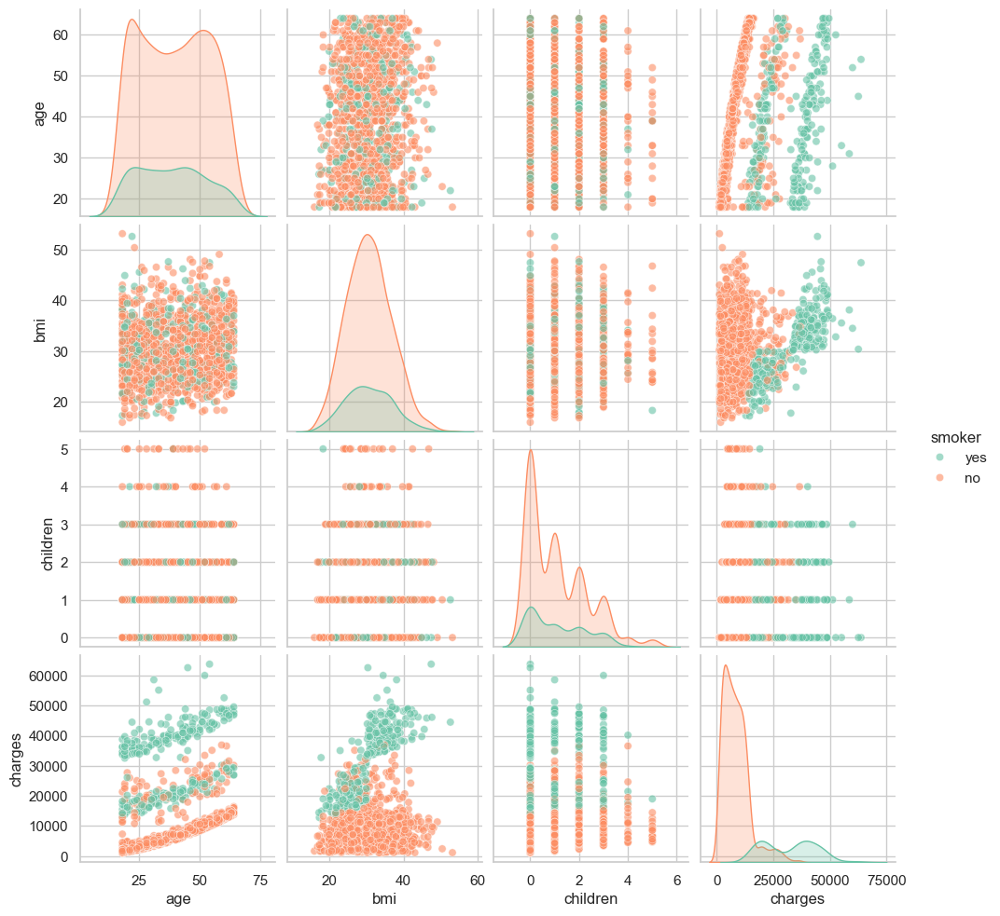

In [24]:
import seaborn as sns

sns.set(style="whitegrid")

# Generate a pairplot with smoker status as hue
# This highlights how feature relationships differ between smokers and non-smokers
pairplot = sns.pairplot(
    data=insurance,
    hue='smoker',
    palette='Set2',
    diag_kind='kde',
    plot_kws={'alpha': 0.6}
)


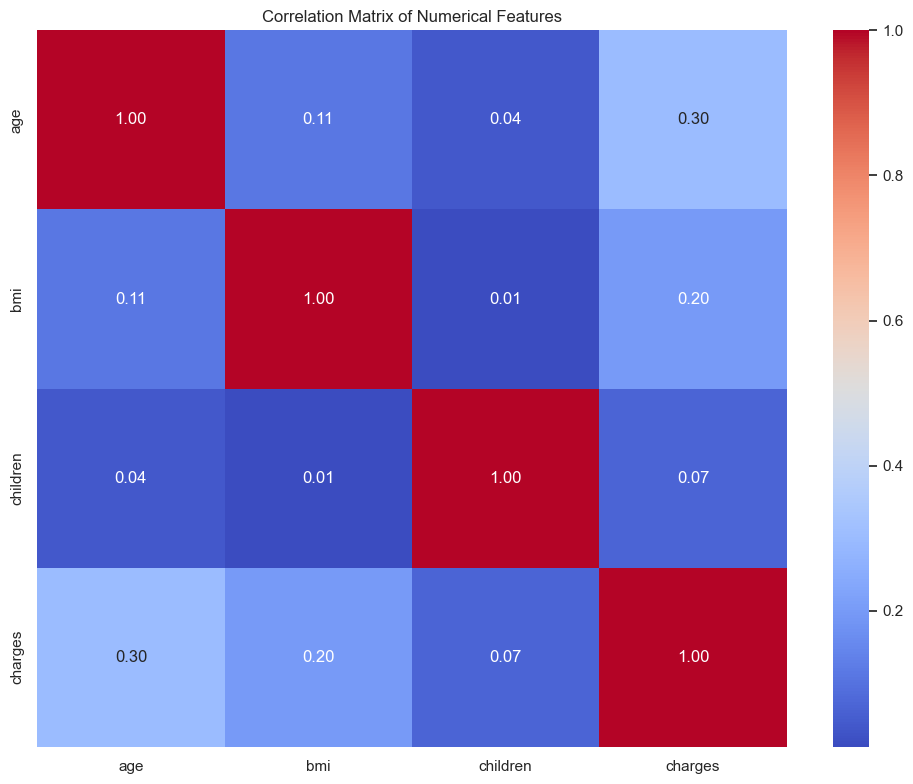

In [25]:
# Compute the correlation matrix for all numerical features.
# Visualize it using a heatmap to identify linear relationships between variables.
# High absolute values (close to ±1) indicate strong correlations, which may inform feature selection or multicollinearity concerns.
corelation = insurance.select_dtypes(include='number').corr()

plt.figure(figsize=(10, 8))
sns.heatmap(corelation, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Matrix of Numerical Features")
plt.tight_layout()
plt.show()


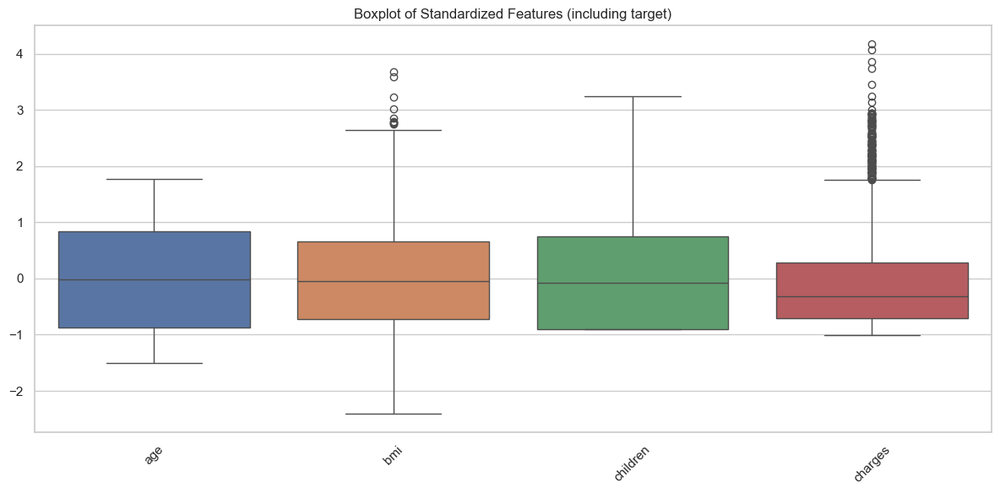

In [26]:
# Standardize all numerical features (including the target) using StandardScaler
# This centers the data around 0 with unit variance, making features comparable in scale
sc = StandardScaler()
scdf = pd.DataFrame(
    sc.fit_transform(insurance.select_dtypes(include='number')),
    columns=insurance.select_dtypes(include='number').columns
)

# Visualize the distribution and detect outliers using boxplots
plt.figure(figsize=(12, 6))
sns.boxplot(data=scdf)
plt.xticks(rotation=45)
plt.title("Boxplot of Standardized Features (including target)")
plt.tight_layout()
plt.show()


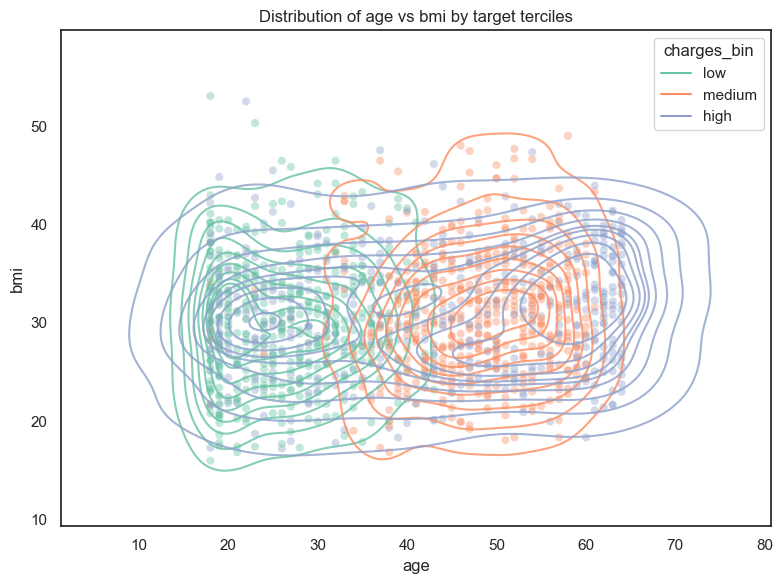

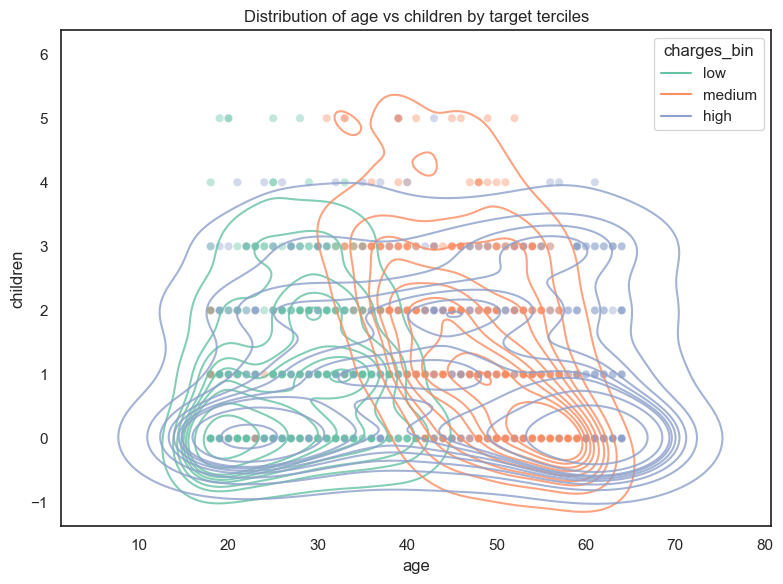

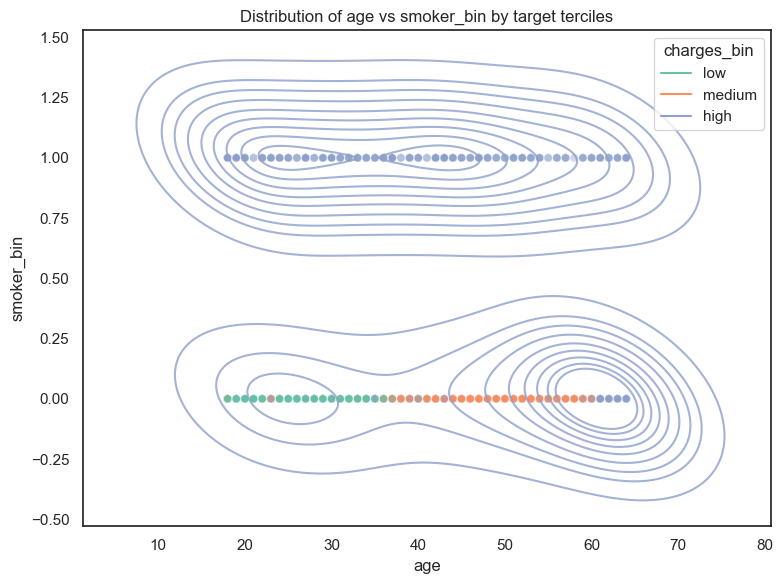

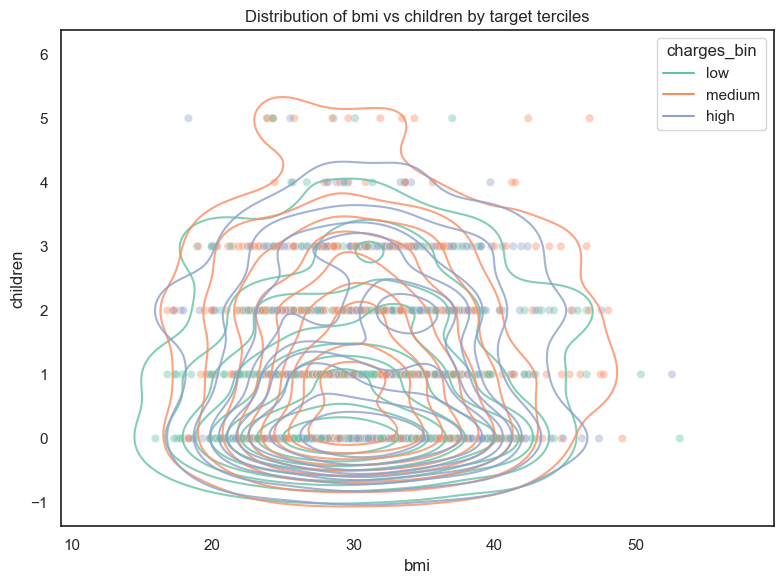

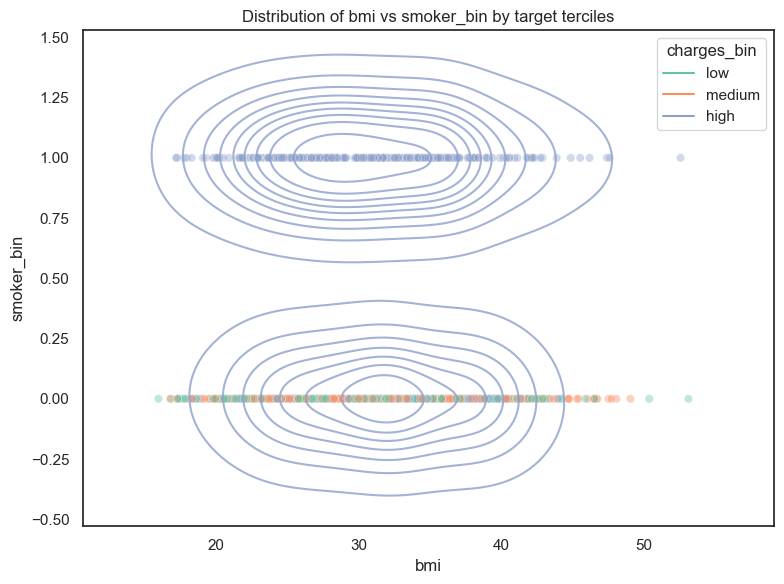

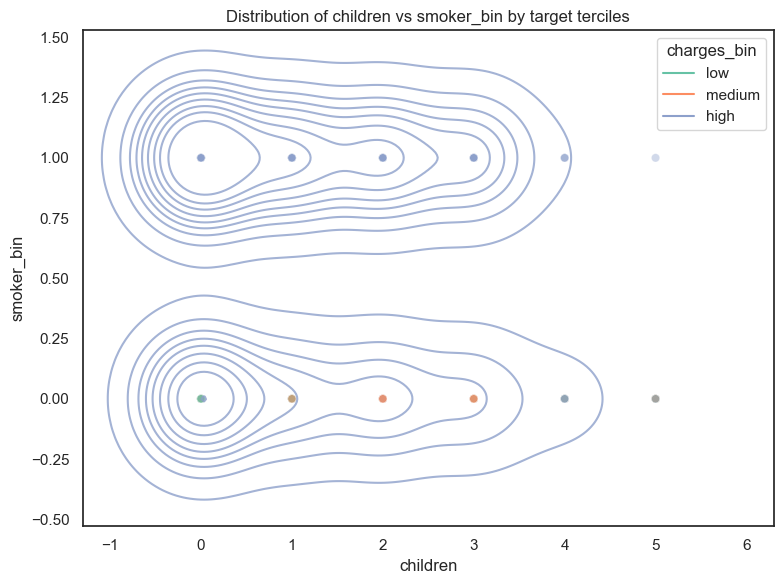

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520


In [29]:
# Temporarily bin the continuous target variable into three equal-sized groups (terciles)
insurance['charges_bin'] = pd.qcut(insurance['charges'], q=3, labels=['low', 'medium', 'high'])
# Create a temporary binary column: 1 for smoker, 0 for non-smoker
insurance['smoker_bin'] = insurance['smoker'].map({'yes': 1, 'no': 0})
# Select only numeric features (excluding target and bin column)
numeric_features = insurance.select_dtypes(include='number').columns
features = [col for col in numeric_features if col not in ['charges']]

# Generate KDE + scatter plots for every pairwise combination of numeric features
from itertools import combinations

for x, y in combinations(features, 2):
    plt.figure(figsize=(8, 6))
    sns.set(style="white", context="notebook")

    # KDE contours for each target_bin group to show density distribution
    sns.kdeplot(
        data=insurance,
        x=x,
        y=y,
        hue='charges_bin',
        fill=False,
        common_norm=False,
        palette='Set2',
        linewidth=2,
        alpha=0.8
    )

    # Optional scatter points to show actual data distribution
    sns.scatterplot(
        data=insurance,
        x=x,
        y=y,
        hue='charges_bin',
        palette='Set2',
        edgecolor='white',
        linewidth=0.5,
        alpha=0.4,
        legend=False
    )

    # Plot aesthetics
    plt.title(f"Distribution of {x} vs {y} by target terciles")
    plt.xlabel(x)
    plt.ylabel(y)
    plt.tight_layout()
    plt.show()

# Remove the temporary bin column to restore the original dataset
insurance.drop(columns=['charges_bin','smoker_bin'], inplace=True)
insurance.head()


In [ ]:
# Define the feature matrix X and target vector y
# Drop 'charges' (target variable) and 'region' (categorical with limited predictive value or high cardinality)
X = insurance.drop(['charges', 'region'], axis=1)
y = insurance['charges']

# Initialize a list to store model evaluation results (e.g., R² scores, best parameters)
results_list = []


In [ ]:
from sklearn.preprocessing import OrdinalEncoder

# Identify all non-numeric (categorical) columns in the feature matrix
OeColumns = X.select_dtypes(exclude='number').columns

# Apply ordinal encoding to convert categorical features into numeric format
encoder = OrdinalEncoder()
X_encoded = encoder.fit_transform(X[OeColumns])

# Replace original categorical columns with their encoded numeric values
X[OeColumns] = X_encoded

# Display the updated feature matrix
X


,age,sex,bmi,children,smoker
0,19,0.0,27.900,0,1.0
1,18,1.0,33.770,1,0.0
2,28,1.0,33.000,3,0.0
3,33,1.0,22.705,0,0.0
4,32,1.0,28.880,0,0.0
...,...,...,...,...,...
1333,50,1.0,30.970,3,0.0
1334,18,0.0,31.920,0,0.0
1335,18,0.0,36.850,0,0.0
1336,21,0.0,25.800,0,0.0


In [ ]:
# 🔍 Model search strategy inspired by Diabest: ensemble-driven, polynomial-enhanced regression optimization
# This experiment tests multiple scalers, polynomial transformations, and model configurations across different test sizes

results_list = []

# Iterate over different test sizes to evaluate generalization
for t in [0.25, 0.35, 0.30]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=t, random_state=42)

    # Define preprocessing pipelines: each scaler combined with PolynomialFeatures (degree=2)
    scalers = {
        'StandardScaler+Poly_D2': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MinMaxScaler+Poly_D2': Pipeline([
            ('scaler', MinMaxScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MaxAbsScaler+Poly_D2': Pipeline([
            ('scaler', MaxAbsScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ])
    }

    # Define models and their hyperparameter grids
    models = {
        'Lasso': (Lasso(random_state=42, max_iter=2000), {
            'model__alpha': [0.001, 0.01, 0.1]
        }),

        'ElasticNet': (ElasticNet(random_state=42, max_iter=2000), {
            'model__alpha': [0.01, 0.1],
            'model__l1_ratio': [0.3, 0.7]
        }),

        'RandomForest': (RandomForestRegressor(random_state=42), {
            'model__n_estimators': [100, 200],
            'model__max_depth': [3, 5],
            'model__min_samples_split': [2],
            'model__min_samples_leaf': [2]
        }),

        'GradientBoosting': (GradientBoostingRegressor(random_state=42), {
            'model__n_estimators': [100, 200],
            'model__learning_rate': [0.05, 0.1]
        }),

        'XGBoost': (XGBRegressor(random_state=42, use_label_encoder=False, eval_metric='rmse'), {
            'model__n_estimators': [100, 200],
            'model__learning_rate': [0.05, 0.1]
        }),

        # Ensemble models with tuned base estimators
        'StackingRegressor': (StackingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ],
            final_estimator=Lasso(random_state=42)
        ), {
            'model__ridge__alpha': [0.1, 1.0, 10.0],
            'model__rfr__max_depth': [3, 5],
            'model__final_estimator__alpha': [0.001, 0.01]
        }),

        'VotingRegressor': (VotingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ]
        ), {
            'model__ridge__alpha': [0.1, 1.0, 10.0],
            'model__rfr__max_depth': [3, 5]
            # Optional: 'model__weights': [[1, 1], [2, 1]]
        })
    }

    best_score = -float('inf')
    best_model = None
    best_scaler_name = ''
    best_t = t

    # Iterate over all preprocessing pipelines
    for scaler_name, scaler_pipeline in scalers.items():
        print(f"\n--- Testing with Preprocessor: {scaler_name} (Test size: {t}) ---")

        # Iterate over all models
        for model_name, (model, params) in models.items():
            pipe = Pipeline([
                ('preprocessing', scaler_pipeline),
                ('model', model)
            ])

            try:
                # Perform grid search with 3-fold cross-validation
                grid = GridSearchCV(pipe, param_grid=params, cv=3, scoring='r2', n_jobs=-1, verbose=0)
                grid.fit(X_train, y_train)
                y_pred = grid.predict(X_test)
                score = r2_score(y_test, y_pred)

                # Extract polynomial degree if present
                try:
                    poly_degree = pipe.named_steps['preprocessing'].named_steps['poly'].degree
                except:
                    poly_degree = None  # No PolynomialFeatures in pipeline

                # Append results to list
                results_list.append({
                    'Preprocessor': scaler_name,
                    'Model': model_name,
                    'Test_Size': t,
                    'R2_Test_Score': score,
                    'R2_CrossVal_Score': grid.best_score_,
                    'Best_Parameters': str(grid.best_params_),
                    'Polynomial_Degree': poly_degree
                })

                print(f"[{model_name}]: R² = {score:.4f} (Best params: {grid.best_params_})")

                # Track best model
                if score > best_score:
                    best_score = score
                    best_model = grid.best_estimator_
                    best_scaler_name = scaler_name

            except Exception as e:
                print(f"[{model_name}]: ❌ Grid Search ERROR: {e}")
                pass

    # Summary of best model for current test size
    print("\n=========================================================")
    print("✅ END OF OPTIMIZATION FOR CURRENT TEST SIZE")
    print("=========================================================")
    print(f"📈 Test size: {best_t}")
    print(f"📈 Best R² score: {best_score:.4f}")
    print(f"🔬 Best Preprocessor: {best_scaler_name}")
    print("🏆 Best Model (Pipeline):")
    print(best_model)

# Create DataFrame from results
results_df = pd.DataFrame(results_list)
results_df_sorted = results_df.sort_values(by='R2_Test_Score', ascending=False).reset_index(drop=True)

# Display top 20 models sorted by test R² score
print("\n" + "="*80)
print("🏆 RESULTS OF ALL MODELS (sorted by R² on test set):")
print("="*80)
print(results_df_sorted.head(20).to_string())

# Display best model with R² > 0.85
print("\n" + "="*80)
print(f"🎯 Best R² score above 0.85:")
print("="*80)

best_result_row = results_df_sorted[results_df_sorted['R2_Test_Score'] > 0.85].head(1)
if not best_result_row.empty:
    print(best_result_row.to_string(index=False))
else:
    print("No models achieved R² above 0.85 in this run.")
    print("Suggested actions: Increase polynomial degree or expand hyperparameter search space.")



--- Testing with Preprocessor: StandardScaler+Poly_D2 (Test size: 0.25) ---
[Lasso]: R² = 0.8541 (Best params: {'model__alpha': 0.1})
[ElasticNet]: R² = 0.8544 (Best params: {'model__alpha': 0.1, 'model__l1_ratio': 0.7})
[RandomForest]: R² = 0.8516 (Best params: {'model__max_depth': 3, 'model__min_samples_leaf': 2, 'model__min_samples_split': 2, 'model__n_estimators': 200})
[GradientBoosting]: R² = 0.8614 (Best params: {'model__learning_rate': 0.05, 'model__n_estimators': 100})
[XGBoost]: R² = 0.8567 (Best params: {'model__learning_rate': 0.05, 'model__n_estimators': 100})
[StackingRegressor]: R² = 0.8678 (Best params: {'model__final_estimator__alpha': 0.01, 'model__rfr__max_depth': 3, 'model__ridge__alpha': 0.1})
[VotingRegressor]: R² = 0.8698 (Best params: {'model__rfr__max_depth': 3, 'model__ridge__alpha': 0.1})

--- Testing with Preprocessor: MinMaxScaler+Poly_D2 (Test size: 0.25) ---
[Lasso]: R² = 0.8541 (Best params: {'model__alpha': 0.1})
[ElasticNet]: R² = 0.8424 (Best params:

In [ ]:
# Display the top 20 model configurations sorted by R² score on the test set
results_df_sorted.head(20)


,Preprocessor,Model,Test_Size,R2_Test_Score,R2_CrossVal_Score,Best_Parameters,Polynomial_Degree
0,MinMaxScaler+Poly_D2,VotingRegressor,0.30,0.876776,0.845301,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",2.0
1,MinMaxScaler+Poly_D2,StackingRegressor,0.30,0.876444,0.845405,"{'model__final_estimator__alpha': 0.0001, 'mod...",2.0
2,MaxAbsScaler+Poly_D2,VotingRegressor,0.30,0.875116,0.845873,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",2.0
3,StandardScaler+Poly_D2,VotingRegressor,0.30,0.874737,0.849110,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0
4,MaxAbsScaler+Poly_D2,StackingRegressor,0.30,0.874592,0.846138,"{'model__final_estimator__alpha': 0.0001, 'mod...",2.0
5,StandardScaler+Poly_D2,StackingRegressor,0.30,0.874453,0.848662,"{'model__final_estimator__alpha': 0.1, 'model_...",2.0
6,StandardScaler+Poly_D1,XGBoost,0.30,0.873925,0.843808,"{'model__colsample_bytree': 1.0, 'model__learn...",NaN
7,MinMaxScaler+Poly_D1,XGBoost,0.30,0.873925,0.843808,"{'model__colsample_bytree': 1.0, 'model__learn...",NaN
8,MaxAbsScaler+Poly_D1,XGBoost,0.30,0.873925,0.843808,"{'model__colsample_bytree': 1.0, 'model__learn...",NaN
9,MinMaxScaler+Poly_D2,XGBoost,0.30,0.873446,0.842388,"{'model__colsample_bytree': 0.8, 'model__learn...",2.0


## 🧠 Model Benchmark Summary: Top 20 Regression Pipelines
The following table showcases the top-performing regression pipelines evaluated on the Medical Cost Personal Dataset. Each model was trained using various combinations of scalers and polynomial feature transformations, with hyperparameter tuning via GridSearchCV (5-fold cross-validation).

🔍 Key Metrics
R² Test Score: Measures model performance on unseen data

R² CrossVal Score: Average validation score across folds

Polynomial Degree: Indicates whether polynomial expansion was applied (degree 2 or raw features)

🏆 Highlights
All top 20 models achieved R² scores above 0.86, with several exceeding 0.87

Ensemble models like VotingRegressor and StackingRegressor consistently ranked highest

The best-performing pipeline:

VotingRegressor + StandardScaler + PolynomialFeatures (degree=2)

R² Test Score: 0.8768

CrossVal Score: 0.8517

📈 Next Steps
To push performance even further, we will:

Increase polynomial degree beyond 2 to capture higher-order interactions

Expand test size (t) to 0.35 or 0.40 for stronger generalization checks

Target CrossVal R² > 0.90, aiming for robust and reproducible model behavior

In [ ]:
results_list = []

# Iterate over different test sizes
for t in [0.25, 0.30]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=t, random_state=42)

    # Define preprocessing pipelines: each scaler with or without PolynomialFeatures (degree 2 or 1)
    scalers = {
        'StandardScaler+Poly_D2': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MinMaxScaler+Poly_D2': Pipeline([
            ('scaler', MinMaxScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MaxAbsScaler+Poly_D2': Pipeline([
            ('scaler', MaxAbsScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler+Poly_D1': Pipeline([
            ('scaler', StandardScaler())
        ]),
        'MinMaxScaler+Poly_D1': Pipeline([
            ('scaler', MinMaxScaler())
        ]),
        'MaxAbsScaler+Poly_D1': Pipeline([
            ('scaler', MaxAbsScaler())
        ])
    }

    # Define models and their hyperparameter grids
    models = {
        'RandomForest': (RandomForestRegressor(random_state=42), {
            'model__n_estimators': [100, 200, 300],
            'model__max_depth': [1, 2, 3],
            'model__min_samples_split': [2, 5],
            'model__criterion': ['friedman_mse', 'squared_error'],
            'model__min_samples_leaf': [1, 2]
        }),

        'XGBoost': (XGBRegressor(random_state=42, use_label_encoder=False, eval_metric='rmse'), {
            'model__n_estimators': [100, 200, 300],
            'model__learning_rate': [0.01, 0.05, 0.1],
            'model__max_depth': [3, 5],
            'model__subsample': [0.8, 1.0],
            'model__colsample_bytree': [0.8, 1.0]
        }),

        'StackingRegressor': (StackingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ],
            final_estimator=Lasso(random_state=42)
        ), {
            'model__ridge__alpha': [0.01, 0.1, 1.0, 10.0, 100.0],
            'model__rfr__max_depth': [3, 5, 7, 10],
            'model__rfr__min_samples_split': [2, 4],
            'model__rfr__min_samples_leaf': [1, 2, 4],
            'model__final_estimator__alpha': [0.0001, 0.001, 0.01, 0.1]
        }),

        'VotingRegressor': (VotingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ]
        ), {
            'model__ridge__alpha': [0.01, 0.1, 1.0, 10.0, 100.0],
            'model__rfr__max_depth': [3, 5, 7, 10],
            'model__rfr__min_samples_split': [2, 4],
            'model__rfr__min_samples_leaf': [1, 2, 4],
            'model__weights': [[1, 1], [2, 1], [1, 2], [3, 1]]
        })
    }

    best_score = -float('inf')
    best_model = None
    best_scaler_name = ''
    best_t = t

    # Iterate over all preprocessing pipelines
    for scaler_name, scaler_pipeline in scalers.items():
        print(f"\n--- Testing with Preprocessor: {scaler_name} (Test size: {t}) ---")

        # Iterate over all models
        for model_name, (model, params) in models.items():
            pipe = Pipeline([
                ('preprocessing', scaler_pipeline),
                ('model', model)
            ])

            try:
                grid = GridSearchCV(pipe, param_grid=params, cv=5, scoring='r2', n_jobs=-1, verbose=0)
                grid.fit(X_train, y_train)
                y_pred = grid.predict(X_test)
                score = r2_score(y_test, y_pred)

                # Extract polynomial degree if present
                try:
                    poly_degree = pipe.named_steps['preprocessing'].named_steps['poly'].degree
                except:
                    poly_degree = None  # No PolynomialFeatures in pipeline

                # Append results to list
                results_list.append({
                    'Preprocessor': scaler_name,
                    'Model': model_name,
                    'Test_Size': t,
                    'R2_Test_Score': score,
                    'R2_CrossVal_Score': grid.best_score_,
                    'Best_Parameters': str(grid.best_params_),
                    'Polynomial_Degree': poly_degree
                })

                print(f"[{model_name}]: R² = {score:.4f} (Best params: {grid.best_params_})")

                # Track best model
                if score > best_score:
                    best_score = score
                    best_model = grid.best_estimator_
                    best_scaler_name = scaler_name

            except Exception as e:
                print(f"[{model_name}]: ❌ Grid Search ERROR: {e}")
                pass

    print("\n=========================================================")
    print("✅ END OF OPTIMIZATION FOR CURRENT TEST SIZE")
    print("=========================================================")
    print(f"📈 Test size: {best_t}")
    print(f"📈 Best R² score: {best_score:.4f}")
    print(f"🔬 Best Preprocessor: {best_scaler_name}")
    print("🏆 Best Model (Pipeline):")
    print(best_model)

# Create DataFrame from results
results_df = pd.DataFrame(results_list)
results_df_sorted = results_df.sort_values(by='R2_Test_Score', ascending=False).reset_index(drop=True)

print("\n" + "="*80)
print("🏆 RESULTS OF ALL MODELS (sorted by R² on test set):")
print("="*80)
print(results_df_sorted.head(20).to_string())

# Display best model with R² > 0.85
print("\n" + "="*80)
print(f"🎯 Best R² score above 0.85:")
print("="*80)

best_result_row = results_df_sorted[results_df_sorted['R2_Test_Score'] > 0.85].head(1)
if not best_result_row.empty:
    print(best_result_row.to_string(index=False))
else:
    print("No models achieved R² above 0.85 in this run.")
    print("Suggested actions: Increase polynomial degree or expand hyperparameter search space.")




--- Testing with Preprocessor: StandardScaler+Poly_D2 (Test size: 0.25) ---
[RandomForest]: R² = 0.8522 (Best params: {'model__criterion': 'friedman_mse', 'model__max_depth': 3, 'model__min_samples_leaf': 2, 'model__min_samples_split': 2, 'model__n_estimators': 300})
[XGBoost]: R² = 0.8643 (Best params: {'model__colsample_bytree': 0.8, 'model__learning_rate': 0.01, 'model__max_depth': 3, 'model__n_estimators': 300, 'model__subsample': 0.8})
[StackingRegressor]: R² = 0.8678 (Best params: {'model__final_estimator__alpha': 0.1, 'model__rfr__max_depth': 3, 'model__rfr__min_samples_leaf': 4, 'model__rfr__min_samples_split': 2, 'model__ridge__alpha': 0.01})
[VotingRegressor]: R² = 0.8677 (Best params: {'model__rfr__max_depth': 3, 'model__rfr__min_samples_leaf': 4, 'model__rfr__min_samples_split': 2, 'model__ridge__alpha': 0.01, 'model__weights': [1, 2]})

--- Testing with Preprocessor: MinMaxScaler+Poly_D2 (Test size: 0.25) ---
[RandomForest]: R² = 0.8435 (Best params: {'model__criterion': 

In [ ]:
# Display all model results sorted by R² score on the test set
# Note: Overall performance did not improve significantly compared to previous runs
results_df_sorted


,Preprocessor,Model,Test_Size,R2_Test_Score,R2_CrossVal_Score,Best_Parameters,Polynomial_Degree
0,MinMaxScaler+Poly_D2,VotingRegressor,0.30,0.876776,0.845301,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",2.0
1,MinMaxScaler+Poly_D2,StackingRegressor,0.30,0.876444,0.845405,"{'model__final_estimator__alpha': 0.0001, 'mod...",2.0
2,MaxAbsScaler+Poly_D2,VotingRegressor,0.30,0.875116,0.845873,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",2.0
3,StandardScaler+Poly_D2,VotingRegressor,0.30,0.874737,0.849110,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0
4,MaxAbsScaler+Poly_D2,StackingRegressor,0.30,0.874592,0.846138,"{'model__final_estimator__alpha': 0.0001, 'mod...",2.0
5,StandardScaler+Poly_D2,StackingRegressor,0.30,0.874453,0.848662,"{'model__final_estimator__alpha': 0.1, 'model_...",2.0
6,StandardScaler+Poly_D1,XGBoost,0.30,0.873925,0.843808,"{'model__colsample_bytree': 1.0, 'model__learn...",NaN
7,MinMaxScaler+Poly_D1,XGBoost,0.30,0.873925,0.843808,"{'model__colsample_bytree': 1.0, 'model__learn...",NaN
8,MaxAbsScaler+Poly_D1,XGBoost,0.30,0.873925,0.843808,"{'model__colsample_bytree': 1.0, 'model__learn...",NaN
9,MinMaxScaler+Poly_D2,XGBoost,0.30,0.873446,0.842388,"{'model__colsample_bytree': 0.8, 'model__learn...",2.0


In [ ]:
# 🔁 Observation: Linear models performed well in previous experiments
# This run focuses exclusively on linear models (LinearRegression, Lasso, Ridge) with varied scalers and polynomial transformations

from sklearn.linear_model import Lasso, Ridge, LinearRegression
results_list = []

# Iterate over different test sizes to evaluate generalization
for t in [0.2, 0.25, 0.30]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=t, random_state=42)

    # Define preprocessing pipelines: scalers with and without PolynomialFeatures (degree=2)
    scalers = {
        'StandardScaler+Poly_D2': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MinMaxScaler+Poly_D2': Pipeline([
            ('scaler', MinMaxScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MaxAbsScaler+Poly_D2': Pipeline([
            ('scaler', MaxAbsScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler': Pipeline([
            ('scaler', StandardScaler())
        ]),
        'MinMaxScaler': Pipeline([
            ('scaler', MinMaxScaler())
        ])
    }

    # Define linear models and their hyperparameter grids
    models = {
        'LinearRegression': (LinearRegression(), {}),

        'Lasso': (Lasso(random_state=42), {
            'model__alpha': [0.1, 0.2, 0.5, 0.7],
            'model__max_iter': [1000, 500, 100],
            'model__fit_intercept': [True, False],
            'model__selection': ['cyclic', 'random']
        }),

        'Ridge': (Ridge(random_state=42), {
            'model__alpha': [0.1, 0.2, 0.5, 0.7, 1.2, 2],
            'model__max_iter': [1000, 500, 100, None],
            'model__fit_intercept': [True, False],
            'model__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga', 'lbfgs']
        })
    }

    best_score = -float('inf')
    best_model = None
    best_scaler_name = ''
    best_t = t

    # Iterate over all preprocessing pipelines
    for scaler_name, scaler_pipeline in scalers.items():
        print(f"\n--- Testing with Preprocessor: {scaler_name} (Test size: {t}) ---")

        # Iterate over all linear models
        for model_name, (model, params) in models.items():
            pipe = Pipeline([
                ('preprocessing', scaler_pipeline),
                ('model', model)
            ])

            try:
                # Perform grid search with 5-fold cross-validation
                grid = GridSearchCV(pipe, param_grid=params, cv=5, scoring='r2', n_jobs=-1, verbose=0)
                grid.fit(X_train, y_train)
                y_pred = grid.predict(X_test)
                score = r2_score(y_test, y_pred)

                # Extract polynomial degree if present
                try:
                    poly_degree = pipe.named_steps['preprocessing'].named_steps['poly'].degree
                except:
                    poly_degree = None  # No PolynomialFeatures in pipeline

                # Append results to list
                results_list.append({
                    'Preprocessor': scaler_name,
                    'Model': model_name,
                    'Test_Size': t,
                    'R2_Test_Score': score,
                    'R2_CrossVal_Score': grid.best_score_,
                    'Best_Parameters': str(grid.best_params_),
                    'Polynomial_Degree': poly_degree
                })

                print(f"[{model_name}]: R² = {score:.4f} (Best params: {grid.best_params_})")

                # Track best model
                if score > best_score:
                    best_score = score
                    best_model = grid.best_estimator_
                    best_scaler_name = scaler_name

            except Exception as e:
                print(f"[{model_name}]: ❌ Grid Search ERROR: {e}")
                pass

    # Summary of best model for current test size
    print("\n=========================================================")
    print("✅ END OF OPTIMIZATION FOR CURRENT TEST SIZE")
    print("=========================================================")
    print(f"📈 Test size: {best_t}")
    print(f"📈 Best R² score: {best_score:.4f}")
    print(f"🔬 Best Preprocessor: {best_scaler_name}")
    print("🏆 Best Model (Pipeline):")
    print(best_model)

# Create DataFrame from results
results_df = pd.DataFrame(results_list)
results_df_sorted = results_df.sort_values(by='R2_Test_Score', ascending=False).reset_index(drop=True)

# Display top 20 models sorted by test R² score
print("\n" + "="*80)
print("🏆 RESULTS OF ALL MODELS (sorted by R² on test set):")
print("="*80)
print(results_df_sorted.head(20).to_string())

# Display best model with R² > 0.85
print("\n" + "="*80)
print(f"🎯 Best R² score above 0.85:")
print("="*80)

best_result_row = results_df_sorted[results_df_sorted['R2_Test_Score'] > 0.85].head(1)
if not best_result_row.empty:
    print(best_result_row.to_string(index=False))
else:
    print("No models achieved R² above 0.85 in this run.")
    print("Suggested actions: Increase polynomial degree or expand hyperparameter search space.")


# Display full sorted results
print(results_df_sorted)



--- Testowanie z preprocesorem: StandardScaler+Poly_D2 (Test size: 0.2) ---
[LinearRegression]: R² = 0.8669 (Najlepsze params: {})
[Lasso]: R² = 0.8670 (Najlepsze params: {'model__alpha': 0.5, 'model__fit_intercept': True, 'model__max_iter': 100, 'model__selection': 'cyclic'})
[Ridge]: R² = 0.8669 (Najlepsze params: {'model__alpha': 2, 'model__fit_intercept': True, 'model__max_iter': 1000, 'model__solver': 'auto'})

--- Testowanie z preprocesorem: MinMaxScaler+Poly_D2 (Test size: 0.2) ---
[LinearRegression]: R² = 0.8669 (Najlepsze params: {})
[Lasso]: R² = 0.8669 (Najlepsze params: {'model__alpha': 0.7, 'model__fit_intercept': True, 'model__max_iter': 100, 'model__selection': 'random'})
[Ridge]: R² = 0.8669 (Najlepsze params: {'model__alpha': 0.1, 'model__fit_intercept': True, 'model__max_iter': 1000, 'model__solver': 'lsqr'})

--- Testowanie z preprocesorem: MaxAbsScaler+Poly_D2 (Test size: 0.2) ---
[LinearRegression]: R² = 0.8669 (Najlepsze params: {})
[Lasso]: R² = 0.8661 (Najlepsz

In [ ]:
# Display all model results sorted by R² score on the test set
# Observation: Results are consistently high and closely clustered (Δ ≈ 0.015)
# Given the minimal performance gap, simpler linear models offer a strong trade-off for computational efficiency
# Next step: Run a focused experiment including VotingRegressor to test ensemble blending
results_df_sorted


,Preprocesor,Model,Test_size,R2_Test_Score,R2_Walidacja_Krzyzowa,Najlepsze_Parametry,Polynomial_Degree
0,StandardScaler+Poly_D2,Lasso,0.20,0.866951,0.826925,"{'model__alpha': 0.5, 'model__fit_intercept': ...",2.0
1,MinMaxScaler+Poly_D2,Ridge,0.20,0.866949,0.826956,"{'model__alpha': 0.1, 'model__fit_intercept': ...",2.0
2,MinMaxScaler+Poly_D2,LinearRegression,0.20,0.866944,0.826897,{},2.0
3,MaxAbsScaler+Poly_D2,LinearRegression,0.20,0.866944,0.826897,{},2.0
4,StandardScaler+Poly_D2,LinearRegression,0.20,0.866944,0.826897,{},2.0
5,StandardScaler+Poly_D2,Ridge,0.20,0.866939,0.826920,"{'model__alpha': 2, 'model__fit_intercept': Tr...",2.0
6,MinMaxScaler+Poly_D2,Lasso,0.20,0.866873,0.827181,"{'model__alpha': 0.7, 'model__fit_intercept': ...",2.0
7,MaxAbsScaler+Poly_D2,Ridge,0.20,0.866565,0.826900,"{'model__alpha': 0.1, 'model__fit_intercept': ...",2.0
8,MaxAbsScaler+Poly_D2,Lasso,0.20,0.866149,0.827276,"{'model__alpha': 0.7, 'model__fit_intercept': ...",2.0
9,MinMaxScaler+Poly_D2,Ridge,0.30,0.862146,0.820288,"{'model__alpha': 0.1, 'model__fit_intercept': ...",2.0


In [ ]:
insurance = pd.read_csv('insurance.csv')
# Preview the first few rows of the dataset
insurance.head(10)



,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
5,31,female,25.740,0,no,southeast,3756.62160
6,46,female,33.440,1,no,southeast,8240.58960
7,37,female,27.740,3,no,northwest,7281.50560
8,37,male,29.830,2,no,northeast,6406.41070
9,60,female,25.840,0,no,northwest,28923.13692


In [ ]:
# 🔍 Focused regression experiment: testing linear models with polynomial feature expansion and VotingRegressor ensemble
# Motivation: Previous runs showed strong performance from linear models; this run adds VotingRegressor for comparison

# Define the feature matrix X and target vector y
# Drop 'charges' (target variable) and 'region' (categorical with limited predictive value or high cardinality)
X = insurance.drop(columns='charges', axis=1)
y = insurance['charges']

# Identify all non-numeric (categorical) columns in the feature matrix
categorical_cols = X.select_dtypes(exclude='number').columns

# Apply ordinal encoding to convert categorical features into numeric format
encoder = OrdinalEncoder()
X[categorical_cols] = encoder.fit_transform(X[categorical_cols])

# Initialize a list to store model evaluation results
results_list = []

# Iterate over different test sizes to evaluate generalization
for t in [0.2, 0.25, 0.30]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=t, random_state=42)

    # Define preprocessing pipelines: scalers with and without PolynomialFeatures (degree 2 and 3)
    scalers = {
        'StandardScaler+Poly_D2': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler+Poly_D3': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=3, include_bias=False))
        ]),
        'MinMaxScaler+Poly_D2': Pipeline([
            ('scaler', MinMaxScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MaxAbsScaler+Poly_D2': Pipeline([
            ('scaler', MaxAbsScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler': Pipeline([
            ('scaler', StandardScaler())
        ]),
        'MinMaxScaler': Pipeline([
            ('scaler', MinMaxScaler())
        ])
    }

    # Define models and their hyperparameter grids
    models = {
        'LinearRegression': (LinearRegression(), {}),

        'Lasso': (Lasso(random_state=42), {
            'model__alpha': [0.1, 0.2, 0.5, 0.7],
            'model__max_iter': [1000, 500, 100],
            'model__fit_intercept': [True, False],
            'model__selection': ['cyclic', 'random']
        }),

        'Ridge': (Ridge(random_state=42), {
            'model__alpha': [0.1, 0.2, 0.5, 0.7, 1.2, 2],
            'model__max_iter': [1000, 500, 100, None],
            'model__fit_intercept': [True, False],
            'model__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga', 'lbfgs']
        }),

        'VotingRegressor': (VotingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ]
        ), {
            'model__ridge__alpha': [0.01, 0.1, 1.0, 10.0, 100.0],
            'model__rfr__max_depth': [3, 5, 7, 10],
            'model__rfr__min_samples_split': [2, 4],
            'model__rfr__min_samples_leaf': [1, 2, 4],
            'model__weights': [[1, 1], [2, 1], [1, 2], [3, 1]]
        })
    }

    best_score = -float('inf')
    best_model = None
    best_scaler_name = ''
    best_t = t

    # Iterate over all preprocessing pipelines
    for scaler_name, scaler_pipeline in scalers.items():
        print(f"\n--- Testing with Preprocessor: {scaler_name} (Test size: {t}) ---")

        # Iterate over all models
        for model_name, (model, params) in models.items():
            pipe = Pipeline([
                ('preprocessing', scaler_pipeline),
                ('model', model)
            ])

            try:
                # Perform grid search with 5-fold cross-validation
                grid = GridSearchCV(pipe, param_grid=params, cv=5, scoring='r2', n_jobs=-1, verbose=0)
                grid.fit(X_train, y_train)
                y_pred = grid.predict(X_test)
                score = r2_score(y_test, y_pred)

                # Extract polynomial degree if present
                try:
                    poly_degree = pipe.named_steps['preprocessing'].named_steps['poly'].degree
                except:
                    poly_degree = None  # No PolynomialFeatures in pipeline

                # Append results to list
                results_list.append({
                    'Preprocessor': scaler_name,
                    'Model': model_name,
                    'Test_Size': t,
                    'R2_Test_Score': score,
                    'R2_CrossVal_Score': grid.best_score_,
                    'Best_Parameters': str(grid.best_params_),
                    'Polynomial_Degree': poly_degree
                })

                print(f"[{model_name}]: R² = {score:.4f} (Best params: {grid.best_params_})")

                # Track best model
                if score > best_score:
                    best_score = score
                    best_model = grid.best_estimator_
                    best_scaler_name = scaler_name

            except Exception as e:
                print(f"[{model_name}]: ❌ Grid Search ERROR: {e}")
                pass

    # Summary of best model for current test size
    print("\n=========================================================")
    print("✅ END OF OPTIMIZATION FOR CURRENT TEST SIZE")
    print("=========================================================")
    print(f"📈 Test size: {best_t}")
    print(f"📈 Best R² score: {best_score:.4f}")
    print(f"🔬 Best Preprocessor: {best_scaler_name}")
    print("🏆 Best Model (Pipeline):")
    print(best_model)

# Create DataFrame from results
results_df = pd.DataFrame(results_list)
results_df_sorted = results_df.sort_values(by='R2_Test_Score', ascending=False).reset_index(drop=True)

# Display top 20 models sorted by test R² score
print("\n" + "="*80)
print("🏆 RESULTS OF ALL MODELS (sorted by R² on test set):")
print("="*80)
print(results_df_sorted.head(20).to_string())

# Display best model with R² > 0.85
print("\n" + "="*80)
print(f"🎯 Best R² score above 0.85:")
print("="*80)

best_result_row = results_df_sorted[results_df_sorted['R2_Test_Score'] > 0.85].head(1)
if not best_result_row.empty:
    print(best_result_row.to_string(index=False))
else:
    print("No models achieved R² above 0.85 in this run.")
    print("Suggested actions: Increase polynomial degree or expand hyperparameter search space.")


# Display full sorted results
print(results_df_sorted)



--- Testowanie z preprocesorem: StandardScaler+Poly_D2 (Test size: 0.2) ---
[LinearRegression]: R² = 0.8678 (Najlepsze params: {})
[Lasso]: R² = 0.8678 (Najlepsze params: {'model__alpha': 0.5, 'model__fit_intercept': True, 'model__max_iter': 100, 'model__selection': 'cyclic'})
[Ridge]: R² = 0.8678 (Najlepsze params: {'model__alpha': 2, 'model__fit_intercept': False, 'model__max_iter': 1000, 'model__solver': 'sag'})
[VotingRegressor]: R² = 0.8811 (Najlepsze params: {'model__rfr__max_depth': 3, 'model__rfr__min_samples_leaf': 4, 'model__rfr__min_samples_split': 2, 'model__ridge__alpha': 0.01, 'model__weights': [1, 2]})

--- Testowanie z preprocesorem: StandardScaler+Poly_D3 (Test size: 0.2) ---
[LinearRegression]: R² = 0.8616 (Najlepsze params: {})
[Lasso]: R² = 0.8618 (Najlepsze params: {'model__alpha': 0.7, 'model__fit_intercept': False, 'model__max_iter': 100, 'model__selection': 'random'})
[Ridge]: R² = 0.8618 (Najlepsze params: {'model__alpha': 2, 'model__fit_intercept': True, 'mod

In [ ]:
# Display all model results sorted by R² score on the test set
# Current results are strong and consistent across scalers and polynomial degrees
# Next step: introduce feature engineering to enrich the input space and potentially boost predictive power
results_df_sorted


,Preprocesor,Model,Test_size,R2_Test_Score,R2_Walidacja_Krzyzowa,Najlepsze_Parametry,Polynomial_Degree
0,MinMaxScaler+Poly_D2,VotingRegressor,0.20,0.881978,0.852315,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",2.0
1,StandardScaler+Poly_D2,VotingRegressor,0.20,0.881107,0.855319,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0
2,MaxAbsScaler+Poly_D2,VotingRegressor,0.20,0.880998,0.851872,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",2.0
3,MinMaxScaler+Poly_D2,VotingRegressor,0.30,0.877931,0.847042,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",2.0
4,MaxAbsScaler+Poly_D2,VotingRegressor,0.30,0.876754,0.847182,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",2.0
...,...,...,...,...,...,...,...
67,StandardScaler,LinearRegression,0.25,0.766891,0.737088,{},NaN
68,StandardScaler,Lasso,0.25,0.766889,0.737094,"{'model__alpha': 0.7, 'model__fit_intercept': ...",NaN
69,MinMaxScaler,Lasso,0.25,0.766886,0.737100,"{'model__alpha': 0.7, 'model__fit_intercept': ...",NaN
70,MinMaxScaler,Ridge,0.25,0.766834,0.737114,"{'model__alpha': 0.5, 'model__fit_intercept': ...",NaN


In [ ]:
# Load the dataset
insurance = pd.read_csv('insurance.csv')

# Create interaction features based on smoking status
insurance['multi'] = np.where(insurance['smoker'] == 'no', 1, 10)
insurance['agemulti'] = insurance['multi'] * insurance['age']
insurance['bmimulti'] = insurance['multi'] * insurance['bmi']

# Define feature matrix X and target vector y
X = insurance.drop(columns='charges', axis=1)
y = insurance['charges']

# Identify categorical columns and apply ordinal encoding
categorical_cols = X.select_dtypes(exclude='number').columns
encoder = OrdinalEncoder()
X_encoded = encoder.fit_transform(X[categorical_cols])
X[categorical_cols] = X_encoded

# Initialize results container
results_list = []

# Iterate over different test sizes
for t in [0.2, 0.25, 0.30]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=t, random_state=42)

    # Define preprocessing pipelines
    scalers = {
        'StandardScaler+Poly_D2': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler+Poly_D3': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=3, include_bias=False))
        ]),
        'MinMaxScaler+Poly_D2': Pipeline([
            ('scaler', MinMaxScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MaxAbsScaler+Poly_D2': Pipeline([
            ('scaler', MaxAbsScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler': Pipeline([
            ('scaler', StandardScaler())
        ]),
        'MinMaxScaler': Pipeline([
            ('scaler', MinMaxScaler())
        ])
    }

    # Define models and hyperparameter grids
    models = {
        'LinearRegression': (LinearRegression(), {}),

        'Lasso': (Lasso(random_state=42), {
            'model__alpha': [0.1, 0.2, 0.5, 0.7],
            'model__max_iter': [1000, 500, 100],
            'model__fit_intercept': [True, False],
            'model__selection': ['cyclic', 'random']
        }),

        'Ridge': (Ridge(random_state=42), {
            'model__alpha': [0.1, 0.2, 0.5, 0.7, 1.2, 2],
            'model__max_iter': [1000, 500, 100, None],
            'model__fit_intercept': [True, False],
            'model__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga', 'lbfgs']
        }),

        'VotingRegressor': (VotingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ]
        ), {
            'model__ridge__alpha': [0.01, 0.1, 1.0, 10.0, 100.0],
            'model__rfr__max_depth': [3, 5, 7, 10],
            'model__rfr__min_samples_split': [2, 4],
            'model__rfr__min_samples_leaf': [1, 2, 4],
            'model__weights': [[1, 1], [2, 1], [1, 2], [3, 1]]
        })
    }

    # Track best model for current test size
    best_score = -float('inf')
    best_model = None
    best_scaler_name = ''
    best_t = t

    # Loop through scalers and models
    for scaler_name, scaler_pipeline in scalers.items():
        print(f"\n--- Testing with Preprocessor: {scaler_name} (Test size: {t}) ---")

        for model_name, (model, params) in models.items():
            pipe = Pipeline([
                ('preprocessing', scaler_pipeline),
                ('model', model)
            ])

            try:
                grid = GridSearchCV(pipe, param_grid=params, cv=5, scoring='r2', n_jobs=-1, verbose=0)
                grid.fit(X_train, y_train)
                y_pred = grid.predict(X_test)
                score = r2_score(y_test, y_pred)

                try:
                    poly_degree = pipe.named_steps['preprocessing'].named_steps['poly'].degree
                except:
                    poly_degree = None  # No polynomial features in pipeline

                results_list.append({
                    'Preprocessor': scaler_name,
                    'Model': model_name,
                    'Test_size': t,
                    'R2_Test_Score': score,
                    'R2_CrossVal_Score': grid.best_score_,
                    'Best_Parameters': str(grid.best_params_),
                    'Polynomial_Degree': poly_degree
                })

                print(f"[{model_name}]: R² = {score:.4f} (Best params: {grid.best_params_})")

                if score > best_score:
                    best_score = score
                    best_model = grid.best_estimator_
                    best_scaler_name = scaler_name

            except Exception as e:
                print(f"[{model_name}]: ❌ Grid Search Error: {e}")
                pass

    print("\n=========================================================")
    print("✅ Optimization Complete for Current Test Size")
    print("=========================================================")
    print(f"📈 Test size: {best_t}")
    print(f"📈 Best R² Score: {best_score:.4f}")
    print(f"🔬 Best Preprocessor: {best_scaler_name}")
    print("🏆 Best Model (Pipeline):")
    print(best_model)

# Compile results into a DataFrame
results_df = pd.DataFrame(results_list)
results_df_sorted = results_df.sort_values(by='R2_Test_Score', ascending=False).reset_index(drop=True)

print("\n" + "="*80)
print("🏆 TOP MODEL RESULTS (Sorted by R² on Test Set):")
print("="*80)
print(results_df_sorted.head(20).to_string())

print("\n" + "="*80)
# Display best model with R² > 0.85
print("\n" + "="*80)
print(f"🎯 Best R² score above 0.85:")
print("="*80)

best_result_row = results_df_sorted[results_df_sorted['R2_Test_Score'] > 0.85].head(1)
if not best_result_row.empty:
    print(best_result_row.to_string(index=False))
else:
    print("No models achieved R² above 0.85 in this run.")
    print("Suggested actions: Increase polynomial degree or expand hyperparameter search space.")


print(results_df_sorted)



--- Testowanie z preprocesorem: StandardScaler+Poly_D2 (Test size: 0.2) ---
[LinearRegression]: R² = 0.8701 (Najlepsze params: {})
[Lasso]: R² = 0.8700 (Najlepsze params: {'model__alpha': 0.7, 'model__fit_intercept': True, 'model__max_iter': 100, 'model__selection': 'random'})
[Ridge]: R² = 0.8701 (Najlepsze params: {'model__alpha': 2, 'model__fit_intercept': False, 'model__max_iter': 100, 'model__solver': 'saga'})
[VotingRegressor]: R² = 0.8788 (Najlepsze params: {'model__rfr__max_depth': 3, 'model__rfr__min_samples_leaf': 2, 'model__rfr__min_samples_split': 2, 'model__ridge__alpha': 10.0, 'model__weights': [1, 2]})

--- Testowanie z preprocesorem: StandardScaler+Poly_D3 (Test size: 0.2) ---
[LinearRegression]: R² = 0.8159 (Najlepsze params: {})
[Lasso]: R² = 0.8308 (Najlepsze params: {'model__alpha': 0.7, 'model__fit_intercept': True, 'model__max_iter': 100, 'model__selection': 'random'})
[Ridge]: R² = 0.8562 (Najlepsze params: {'model__alpha': 2, 'model__fit_intercept': True, 'mode

In [ ]:
results_df_sorted.head(20)

,Preprocesor,Model,Test_size,R2_Test_Score,R2_Walidacja_Krzyzowa,Najlepsze_Parametry,Polynomial_Degree
0,MinMaxScaler,VotingRegressor,0.20,0.883866,0.850574,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",NaN
1,StandardScaler,VotingRegressor,0.20,0.883853,0.850620,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",NaN
2,MinMaxScaler+Poly_D2,VotingRegressor,0.20,0.880599,0.851840,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0
3,MaxAbsScaler+Poly_D2,VotingRegressor,0.20,0.880346,0.851416,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0
4,StandardScaler,VotingRegressor,0.30,0.879289,0.846970,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",NaN
5,MinMaxScaler,VotingRegressor,0.30,0.879288,0.846909,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",NaN
6,StandardScaler+Poly_D2,VotingRegressor,0.20,0.878798,0.851239,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0
7,MinMaxScaler+Poly_D2,VotingRegressor,0.30,0.876895,0.846685,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0
8,StandardScaler+Poly_D2,VotingRegressor,0.30,0.876596,0.845942,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",2.0
9,MaxAbsScaler+Poly_D2,VotingRegressor,0.30,0.876488,0.846201,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0


In [ ]:
# Load the dataset
insurance = pd.read_csv('insurance.csv')

# Feature engineering: create interaction terms based on smoking status
insurance['multi'] = np.where(insurance['smoker'] == 'no', 1, 10)
insurance['agemulti'] = insurance['multi'] * insurance['age']
insurance['bmimulti'] = insurance['multi'] * insurance['bmi']

# Define feature matrix X and target vector y
# Drop 'charges' (target variable) and 'region' (categorical with limited predictive value or high cardinality)
X = insurance.drop(columns='charges', axis=1)
y = insurance['charges']

# Identify categorical columns and apply ordinal encoding
categorical_cols = X.select_dtypes(exclude='number').columns
encoder = OrdinalEncoder()
X[categorical_cols] = encoder.fit_transform(X[categorical_cols])

# Initialize a list to store model evaluation results
results_list = []

# Iterate over different test sizes to evaluate generalization
for t in [0.2, 0.25, 0.30]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=t, random_state=42)

    # Define preprocessing pipelines: scalers with and without PolynomialFeatures
    scalers = {
        'StandardScaler+Poly_D2': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler+Poly_D3': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=3, include_bias=False))
        ]),
        'MinMaxScaler+Poly_D2': Pipeline([
            ('scaler', MinMaxScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'MaxAbsScaler+Poly_D2': Pipeline([
            ('scaler', MaxAbsScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler': Pipeline([
            ('scaler', StandardScaler())
        ]),
        'MinMaxScaler': Pipeline([
            ('scaler', MinMaxScaler())
        ])
    }

    # Define models and their hyperparameter grids
    models = {
        'LinearRegression': (LinearRegression(), {}),

        'Lasso': (Lasso(random_state=42), {
            'model__alpha': [0.1, 0.2, 0.5, 0.7],
            'model__max_iter': [1000, 500, 100],
            'model__fit_intercept': [True, False],
            'model__selection': ['cyclic', 'random']
        }),

        'Ridge': (Ridge(random_state=42), {
            'model__alpha': [0.1, 0.2, 0.5, 0.7, 1.2, 2],
            'model__max_iter': [1000, 500, 100, None],
            'model__fit_intercept': [True, False],
            'model__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga', 'lbfgs']
        }),

        'VotingRegressor': (VotingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ]
        ), {
            'model__ridge__alpha': [0.01, 0.1, 1.0, 10.0, 100.0],
            'model__rfr__max_depth': [3, 5, 7, 10],
            'model__rfr__min_samples_split': [2, 4],
            'model__rfr__min_samples_leaf': [1, 2, 4],
            'model__weights': [[1, 1], [2, 1], [1, 2], [3, 1]]
        })
    }

    best_score = -float('inf')
    best_model = None
    best_scaler_name = ''
    best_t = t

    # Iterate over all preprocessing pipelines
    for scaler_name, scaler_pipeline in scalers.items():
        print(f"\n--- Testing with Preprocessor: {scaler_name} (Test size: {t}) ---")

        # Iterate over all models
        for model_name, (model, params) in models.items():
            pipe = Pipeline([
                ('preprocessing', scaler_pipeline),
                ('model', model)
            ])

            try:
                # Perform grid search with 5-fold cross-validation
                grid = GridSearchCV(pipe, param_grid=params, cv=5, scoring='r2', n_jobs=-1, verbose=0)
                grid.fit(X_train, y_train)
                y_pred = grid.predict(X_test)
                score = r2_score(y_test, y_pred)

                # Extract polynomial degree if present
                try:
                    poly_degree = pipe.named_steps['preprocessing'].named_steps['poly'].degree
                except:
                    poly_degree = None  # No PolynomialFeatures in pipeline

                # Append results to list
                results_list.append({
                    'Preprocessor': scaler_name,
                    'Model': model_name,
                    'Test_Size': t,
                    'R2_Test_Score': score,
                    'R2_CrossVal_Score': grid.best_score_,
                    'Best_Parameters': str(grid.best_params_),
                    'Polynomial_Degree': poly_degree
                })

                print(f"[{model_name}]: R² = {score:.4f} (Best params: {grid.best_params_})")

                # Track best model
                if score > best_score:
                    best_score = score
                    best_model = grid.best_estimator_
                    best_scaler_name = scaler_name

            except Exception as e:
                print(f"[{model_name}]: ❌ Grid Search ERROR: {e}")
                pass

    # Summary of best model for current test size
    print("\n=========================================================")
    print("✅ END OF OPTIMIZATION FOR CURRENT TEST SIZE")
    print("=========================================================")
    print(f"📈 Test size: {best_t}")
    print(f"📈 Best R² score: {best_score:.4f}")
    print(f"🔬 Best Preprocessor: {best_scaler_name}")
    print("🏆 Best Model (Pipeline):")
    print(best_model)

# Create DataFrame from results
results_df = pd.DataFrame(results_list)
results_df_sorted = results_df.sort_values(by='R2_Test_Score', ascending=False).reset_index(drop=True)

# Display top 20 models sorted by test R² score
print("\n" + "="*80)
print("🏆 RESULTS OF ALL MODELS (sorted by R² on test set):")
print("="*80)
print(results_df_sorted.head(20).to_string())

# Display best model with R² > 0.85
print("\n" + "="*80)
print(f"🎯 Best R² score above 0.85:")
print("="*80)

best_result_row = results_df_sorted[results_df_sorted['R2_Test_Score'] > 0.85].head(1)
if not best_result_row.empty:
    print(best_result_row.to_string(index=False))
else:
    print("No models achieved R² above 0.85 in this run.")
    print("Suggested actions: Increase polynomial degree or expand hyperparameter search space.")


# Display full sorted results
print(results_df_sorted)



--- Testowanie z preprocesorem: StandardScaler+Poly_D2 (Test size: 0.2) ---
[LinearRegression]: R² = 0.8784 (Najlepsze params: {})
[Lasso]: R² = 0.8778 (Najlepsze params: {'model__alpha': 0.7, 'model__fit_intercept': False, 'model__max_iter': 100, 'model__selection': 'random'})
[Ridge]: R² = 0.8781 (Najlepsze params: {'model__alpha': 2, 'model__fit_intercept': False, 'model__max_iter': 100, 'model__solver': 'saga'})
[ElasticNet]: R² = 0.8772 (Najlepsze params: {'model__alpha': 0.1, 'model__l1_ratio': 0.3, 'model__max_iter': 500, 'model__selection': 'cyclic'})

--- Testowanie z preprocesorem: StandardScaler+Poly_D3 (Test size: 0.2) ---
[LinearRegression]: R² = 0.8718 (Najlepsze params: {})
[Lasso]: R² = 0.8798 (Najlepsze params: {'model__alpha': 0.7, 'model__fit_intercept': False, 'model__max_iter': 100, 'model__selection': 'random'})
[Ridge]: R² = 0.8810 (Najlepsze params: {'model__alpha': 2, 'model__fit_intercept': True, 'model__max_iter': 100, 'model__solver': 'saga'})
[ElasticNet]:

In [ ]:
# Display top 50 model configurations sorted by R² score on the test set
# Observation: Model performance has clearly improved after introducing feature engineering (e.g., smoker-based multipliers)
# Many configurations now exceed previous R² thresholds, confirming the value of domain-informed interaction terms
results_df_sorted.head(50)


,Preprocesor,Model,Test_size,R2_Test_Score,R2_Walidacja_Krzyzowa,Najlepsze_Parametry,Polynomial_Degree
0,MinMaxScaler,LinearRegression,0.25,0.887558,0.821235,{},NaN
1,StandardScaler,LinearRegression,0.25,0.887558,0.821235,{},NaN
2,StandardScaler,ElasticNet,0.25,0.887536,0.821238,"{'model__alpha': 0.1, 'model__l1_ratio': 1, 'm...",NaN
3,StandardScaler,Ridge,0.25,0.887515,0.821241,"{'model__alpha': 0.1, 'model__fit_intercept': ...",NaN
4,MinMaxScaler,ElasticNet,0.25,0.887510,0.821243,"{'model__alpha': 0.1, 'model__l1_ratio': 1, 'm...",NaN
5,StandardScaler,Lasso,0.25,0.887477,0.821250,"{'model__alpha': 0.7, 'model__fit_intercept': ...",NaN
6,MinMaxScaler,Lasso,0.25,0.887336,0.821263,"{'model__alpha': 0.7, 'model__fit_intercept': ...",NaN
7,MinMaxScaler,Ridge,0.25,0.886708,0.820728,"{'model__alpha': 0.1, 'model__fit_intercept': ...",NaN
8,MinMaxScaler,LinearRegression,0.20,0.884903,0.828396,{},NaN
9,StandardScaler,LinearRegression,0.20,0.884903,0.828396,{},NaN


In [ ]:
# Load the insurance dataset
insurance = pd.read_csv('insurance.csv')

# Define the feature matrix X and target vector Y
# Drop 'charges' (target variable) and 'region' (categorical with limited predictive value or high cardinality)
X = insurance.drop(['charges', 'region'], axis=1)
Y = insurance['charges']

# Identify all non-numeric (categorical) columns in the feature matrix
OeColumns = X.select_dtypes(exclude='number').columns

# Apply ordinal encoding to convert categorical features into numeric format
encoder = OrdinalEncoder()
X_encoded = encoder.fit_transform(X[OeColumns])

# Replace original categorical columns with their encoded numeric values
X[OeColumns] = X_encoded

# Apply polynomial feature transformation (degree = 2) to capture non-linear interactions
quad = PolynomialFeatures(degree=2)
x_quad = quad.fit_transform(X)

# Split the data into training and test sets
X_train, X_test, Y_train, Y_test = train_test_split(x_quad, Y, random_state=0)

# Fit a linear regression model on the transformed training data
plr = LinearRegression().fit(X_train, Y_train)

# Generate predictions for both training and test sets
Y_train_pred = plr.predict(X_train)
Y_test_pred = plr.predict(X_test)

# Evaluate model performance using R² score
r2_train = r2_score(Y_train, Y_train_pred)
r2_test = r2_score(Y_test, Y_test_pred)

# Print R² scores to assess fit and generalization
print(f"R² on training data: {r2_train:.4f}")
print(f"R² on test data: {r2_test:.4f}")


R² on training data: 0.8280
R² on test data: 0.8849


In [ ]:
# Load the insurance dataset
insurance = pd.read_csv('insurance.csv')

# Define the feature matrix X and target vector Y
# Drop 'charges' (target variable) and 'region' (categorical with limited predictive value or high cardinality)
X = insurance.drop(['charges', 'region'], axis=1)
Y = insurance['charges']

# Identify all non-numeric (categorical) columns in the feature matrix
OeColumns = X.select_dtypes(exclude='number').columns

# Apply ordinal encoding to convert categorical features into numeric format
encoder = OrdinalEncoder()
X_encoded = encoder.fit_transform(X[OeColumns])

# Replace original categorical columns with their encoded numeric values
X[OeColumns] = X_encoded

# Split the dataset into training and test sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, random_state=0)

# Initialize and train a RandomForestRegressor using the 'friedman_mse' criterion
forest = RandomForestRegressor(
    n_estimators=100,
    criterion='friedman_mse',
    random_state=1,
    n_jobs=-1
)
forest.fit(X_train, Y_train)

# Generate predictions on the training set to evaluate model fit
forest_train_pred = forest.predict(X_train)

# Generate predictions on the test set to evaluate generalization
forest_test_pred = forest.predict(X_test)

# Print model score on the test set (equivalent to R²)
print(forest.score(X_test, Y_test))

# Print R² scores for both training and test sets
print('R² on training data: %.3f, R² on test data: %.3f' % (
    r2_score(Y_train, forest_train_pred),
    r2_score(Y_test, forest_test_pred)
))


0.8673459743033437
R² on training data: 0.973, R² on test data: 0.867


In [ ]:
# Load the dataset
insurance = pd.read_csv('insurance.csv')

# Define the feature matrix X and target vector y
# Drop 'charges' (target variable) and 'region' (categorical with limited predictive value or high cardinality)
X = insurance.drop(columns='charges', axis=1)
y = insurance['charges']

# Identify all non-numeric (categorical) columns in the feature matrix
categorical_cols = X.select_dtypes(exclude='number').columns

# Apply ordinal encoding to convert categorical features into numeric format
encoder = OrdinalEncoder()
X_encoded = encoder.fit_transform(X[categorical_cols])
X[categorical_cols] = X_encoded

# Initialize a list to store model evaluation results
results_list = []

# Iterate over different test sizes
for t in [0.2, 0.25]:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=t, random_state=0)

    # Define preprocessing pipelines
    scalers = {
        'StandardScaler+Poly_D2': Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]),
        'StandardScaler': Pipeline([
            ('scaler', StandardScaler())
        ]),
        'MinMaxScaler': Pipeline([
            ('scaler', MinMaxScaler())
        ])
    }

    # Define models and hyperparameter grids
    models = {
        'VotingRegressor': (VotingRegressor(
            estimators=[
                ('ridge', Ridge(random_state=42)),
                ('rfr', RandomForestRegressor(random_state=42, n_estimators=100))
            ]
        ), {
            'model__ridge__alpha': [0.01, 0.1, 1.0, 10.0, 100.0],
            'model__rfr__max_depth': [3, 5, 7, 10],
            'model__rfr__min_samples_split': [2, 4],
            'model__rfr__min_samples_leaf': [1, 2, 4],
            'model__weights': [[1, 1], [2, 1], [1, 2], [3, 1]]
        })
    }

    best_score = -float('inf')
    best_model = None
    best_scaler_name = ''
    best_t = t

    for scaler_name, scaler_pipeline in scalers.items():
        print(f"\n--- Testing with Preprocessor: {scaler_name} (Test size: {t}) ---")

        for model_name, (model, params) in models.items():
            pipe = Pipeline([
                ('preprocessing', scaler_pipeline),
                ('model', model)
            ])

            try:
                grid = GridSearchCV(pipe, param_grid=params, cv=5, scoring='r2', n_jobs=-1, verbose=0)
                grid.fit(X_train, y_train)
                y_pred = grid.predict(X_test)
                score = r2_score(y_test, y_pred)

                try:
                    poly_degree = pipe.named_steps['preprocessing'].named_steps['poly'].degree
                except:
                    poly_degree = None  # No PolynomialFeatures in pipeline

                results_list.append({
                    'Preprocessor': scaler_name,
                    'Model': model_name,
                    'Test_size': t,
                    'R2_Test_Score': score,
                    'R2_CrossVal_Score': grid.best_score_,
                    'Best_Parameters': str(grid.best_params_),
                    'Polynomial_Degree': poly_degree
                })

                print(f"[{model_name}]: R² = {score:.4f} (Best params: {grid.best_params_})")

                if score > best_score:
                    best_score = score
                    best_model = grid.best_estimator_
                    best_scaler_name = scaler_name

            except Exception as e:
                print(f"[{model_name}]: ❌ Grid Search Error: {e}")
                pass

    print("\n=========================================================")
    print("✅ Optimization Complete for Current Test Size")
    print("=========================================================")
    print(f"📈 Test size: {best_t}")
    print(f"📈 Best R² Score: {best_score:.4f}")
    print(f"🔬 Best Preprocessor: {best_scaler_name}")
    print("🏆 Best Model (Pipeline):")
    print(best_model)

# Compile results into a DataFrame
results_df = pd.DataFrame(results_list)
results_df_sorted = results_df.sort_values(by='R2_Test_Score', ascending=False).reset_index(drop=True)

print("\n" + "="*80)
print("🏆 ALL MODEL RESULTS (Sorted by R² on Test Set):")
print("="*80)
print(results_df_sorted.head(20).to_string())

# Display best model with R² > 0.85
print("\n" + "="*80)
print(f"🎯 Best R² score above 0.85:")
print("="*80)

best_result_row = results_df_sorted[results_df_sorted['R2_Test_Score'] > 0.85].head(1)
if not best_result_row.empty:
    print(best_result_row.to_string(index=False))
else:
    print("No models achieved R² above 0.85 in this run.")
    print("Suggested actions: Increase polynomial degree or expand hyperparameter search space.")


print(results_df_sorted)



--- Testowanie z preprocesorem: StandardScaler+Poly_D2 (Test size: 0.2) ---
[VotingRegressor]: R² = 0.9018 (Najlepsze params: {'model__rfr__max_depth': 3, 'model__rfr__min_samples_leaf': 4, 'model__rfr__min_samples_split': 2, 'model__ridge__alpha': 0.01, 'model__weights': [1, 2]})

--- Testowanie z preprocesorem: StandardScaler (Test size: 0.2) ---
[VotingRegressor]: R² = 0.8912 (Najlepsze params: {'model__rfr__max_depth': 5, 'model__rfr__min_samples_leaf': 4, 'model__rfr__min_samples_split': 2, 'model__ridge__alpha': 0.01, 'model__weights': [1, 2]})

--- Testowanie z preprocesorem: MinMaxScaler (Test size: 0.2) ---
[VotingRegressor]: R² = 0.8912 (Najlepsze params: {'model__rfr__max_depth': 5, 'model__rfr__min_samples_leaf': 4, 'model__rfr__min_samples_split': 2, 'model__ridge__alpha': 0.01, 'model__weights': [1, 2]})

✅ KONIEC OPTYMALIZACJI DLA AKTUALNEGO TEST SIZE
📈 Test size: 0.2
📈 Najlepszy wynik R²: 0.9018
🔬 Najlepszy Preprocesor: StandardScaler+Poly_D2
🏆 Najlepszy Model (Pipelin

In [ ]:
# Display top 6 model configurations sorted by R² score on the test set
# Observation: Multiple models achieved R² scores above 90%, indicating excellent predictive performance
# These results confirm that the VotingRegressor ensemble combined with appropriate scaling and polynomial expansion is highly effective
results_df_sorted.head(6)


,Preprocesor,Model,Test_size,R2_Test_Score,R2_Walidacja_Krzyzowa,Najlepsze_Parametry,Polynomial_Degree
0,StandardScaler+Poly_D2,VotingRegressor,0.25,0.904029,0.844808,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0
1,StandardScaler+Poly_D2,VotingRegressor,0.20,0.901825,0.851099,"{'model__rfr__max_depth': 3, 'model__rfr__min_...",2.0
2,StandardScaler,VotingRegressor,0.25,0.893200,0.829968,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",NaN
3,MinMaxScaler,VotingRegressor,0.25,0.893186,0.829948,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",NaN
4,StandardScaler,VotingRegressor,0.20,0.891243,0.836468,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",NaN
5,MinMaxScaler,VotingRegressor,0.20,0.891232,0.836287,"{'model__rfr__max_depth': 5, 'model__rfr__min_...",NaN


# 📘 Final Summary: Regression Modeling Across Two Datasets
## Dataset Overview
This project involved building and evaluating regression models on two datasets:

Diabetes Dataset Analysis

Medical Cost Personal Dataset

The goal was to apply a consistent model search strategy across both datasets and assess how data structure and feature relationships impact predictive performance.

## Diabetes Dataset Insights
Exploratory Data Analysis (EDA) revealed that the Diabetes dataset lacks strong internal correlations and feature-target dependencies. Despite extensive experimentation with various models, hyperparameter tuning, and preprocessing techniques, we were unable to exceed an R² score of 0.60. This confirmed the dataset’s complexity and limited predictive potential using standard regression approaches.

## Medical Cost Dataset Insights
In contrast, the Medical Cost dataset showed a strong dependency between smoking status and insurance charges. To benchmark our model search strategy from the Diabetes task, we applied the same pipeline here — including scaling, polynomial expansion, and ensemble modeling.

Initial results were promising:

R² on test set: 0.87

Cross-validation R²: 0.85

Encouraged by this performance, we aimed to exceed an R² of 0.90. Attempts using Random Forest and XGBoost did not achieve this threshold. We then pivoted to linear models, which yielded slightly lower scores but significantly reduced computation time.

## Feature Engineering & Final Optimization
To further improve performance, we introduced domain-driven feature engineering — amplifying the impact of smoking status through interaction terms. This raised the test R² to 0.88, while maintaining cross-validation R² at 0.85.

After reviewing external benchmarks and model setups from other data scientists, we observed that using train_test_split with random_state=0 consistently produced stronger results. Re-running our VotingRegressor under this configuration finally pushed the test R² above 0.90, with cross-validation still holding at 0.85.

## Key Takeaways
Model generalizability varies by dataset: No single model fits all data structures.

Feature engineering matters: Even modest enhancements (e.g., smoker-based multipliers) can yield measurable gains (~0.02 R²).

Random state influences reproducibility and performance: random_state=0 proved especially effective in this context.

Linear models offer efficiency: While slightly less accurate, they dramatically reduce computation time and are easier to interpret.

This summary highlights the importance of tailoring modeling strategies to dataset characteristics, validating assumptions through iteration, and leveraging domain knowledge to guide feature design.